# ⚙️ Predictive Maintenance on Residential Air conditioning system

# Setup dataset

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_style("darkgrid")
sns.set_palette("bright6")
sns.color_palette('bright6')

[(0.00784313725490196, 0.24313725490196078, 1.0),
 (0.10196078431372549, 0.788235294117647, 0.2196078431372549),
 (0.9098039215686274, 0.0, 0.043137254901960784),
 (0.5450980392156862, 0.16862745098039217, 0.8862745098039215),
 (1.0, 0.7686274509803922, 0.0),
 (0.0, 0.8431372549019608, 1.0)]

In [2]:
# Import Dataset
df_indoor = pd.read_csv("data/Indoor_data.csv")
df_outdoor = pd.read_csv("data/Outdoor_data.csv")
df_indoor.head()

,time,title,Airflow indoor-Indoor,Motor FCU-Indoor,Eqv.Current (Evaporator)-Indoor,Indoor Supply Air Temp (Evaporator)-Indoor,Indoor Ambient Temperature-Indoor,Eqv Phase to Phase Voltage (Evaporator)-Indoor,Indoor Return Temp (Evaporator)-Indoor,Indoor Ambient Humidity-Indoor
0,2024-01-16 13:12:30+07:00,Gateway-Thaiken-01,NaN,NaN,NaN,NaN,NaN,388.83,NaN,NaN
1,2024-01-16 13:13:00+07:00,Gateway-Thaiken-01,5.3,88.1,3.33,16.0,24.1,NaN,26.8,40.8
2,2024-01-16 13:13:30+07:00,Gateway-Thaiken-01,5.5,88.0,3.33,16.0,24.1,388.70,26.9,40.9
3,2024-01-16 13:14:30+07:00,Gateway-Thaiken-01,5.5,87.6,3.34,16.1,24.1,389.31,26.9,41.0
4,2024-01-16 13:15:30+07:00,Gateway-Thaiken-01,5.3,88.0,3.34,16.3,24.1,388.90,27.0,41.1


In [3]:
df_outdoor.head()

,time,title,Eqv.Current (Condensor1)-Outdoor,Eqv.Current (Condensor2)-Outdoor,Low compressor 1 (Condensor1)-Outdoor,Outdoor_Liquid_com1 (Condensor1)-Outdoor,Outdoor Ambient Temperature-Outdoor,Eqv Phase to Phase Voltage (Condensor1)-Outdoor,Eqv Phase to Phase Voltage (Condensor2)-Outdoor,High compressor 1 (Condensor1)-Outdoor,Outdoor_Suction_Com1 (Condensor1)-Outdoor,Outdoor Ambient Humidity-Outdoor,Low compressor 2 (Condensor2)-Outdoor,Outdoor_Discharge_Temp_Com1 (Condensor1)-Outdoor,High compressor 2 (Condensor2)-Outdoor,Outdoor_Liquid_Com2 (Condensor2)-Outdoor,Outdoor_Discharge_Temp_Com2 (Condensor2)-Outdoor,Outdoor_Suction_Com2 (Condensor2)-Outdoor
0,2024-01-16 13:13:00+07:00,Gateway-Thaiken-01,5.38,19.43,64.70,25.0,34.8,389.48,389.28,170.29,30.4,32.7,51.81,30.3,315.41,39.6,79.5,17.6
1,2024-01-16 13:13:30+07:00,Gateway-Thaiken-01,5.35,19.60,65.45,24.9,34.8,388.92,388.80,170.54,30.6,33.1,52.08,29.9,317.61,39.7,79.5,17.6
2,2024-01-16 13:14:30+07:00,Gateway-Thaiken-01,5.41,19.54,65.88,24.8,34.8,390.04,389.84,171.56,30.8,33.5,51.46,29.6,317.48,40.0,79.8,17.8
3,2024-01-16 13:15:30+07:00,Gateway-Thaiken-01,5.35,19.62,65.99,24.7,34.9,387.93,388.12,171.81,31.0,33.8,51.89,29.3,318.91,39.9,80.1,18.1
4,2024-01-16 13:16:30+07:00,Gateway-Thaiken-01,5.29,19.73,65.05,24.7,34.9,386.76,386.50,171.68,31.2,33.4,51.93,29.1,320.59,40.3,80.4,18.3


Start with drop the title column and merge 2 tables with inner join

In [4]:
# Clear the title column
df_indoor = df_indoor.drop('title', axis=1)
df_outdoor = df_outdoor.drop('title', axis=1)

# Inner join : combine records from two tables whenever there are matching values in a field common to both tables.
join_on = "time"
df_combined = df_indoor.merge(df_outdoor, on=join_on, how="inner")
df_combined.head()

,time,Airflow indoor-Indoor,Motor FCU-Indoor,Eqv.Current (Evaporator)-Indoor,Indoor Supply Air Temp (Evaporator)-Indoor,Indoor Ambient Temperature-Indoor,Eqv Phase to Phase Voltage (Evaporator)-Indoor,Indoor Return Temp (Evaporator)-Indoor,Indoor Ambient Humidity-Indoor,Eqv.Current (Condensor1)-Outdoor,...,Eqv Phase to Phase Voltage (Condensor2)-Outdoor,High compressor 1 (Condensor1)-Outdoor,Outdoor_Suction_Com1 (Condensor1)-Outdoor,Outdoor Ambient Humidity-Outdoor,Low compressor 2 (Condensor2)-Outdoor,Outdoor_Discharge_Temp_Com1 (Condensor1)-Outdoor,High compressor 2 (Condensor2)-Outdoor,Outdoor_Liquid_Com2 (Condensor2)-Outdoor,Outdoor_Discharge_Temp_Com2 (Condensor2)-Outdoor,Outdoor_Suction_Com2 (Condensor2)-Outdoor
0,2024-01-16 13:13:00+07:00,5.3,88.1,3.33,16.0,24.1,NaN,26.8,40.8,5.38,...,389.28,170.29,30.4,32.7,51.81,30.3,315.41,39.6,79.5,17.6
1,2024-01-16 13:13:30+07:00,5.5,88.0,3.33,16.0,24.1,388.70,26.9,40.9,5.35,...,388.80,170.54,30.6,33.1,52.08,29.9,317.61,39.7,79.5,17.6
2,2024-01-16 13:14:30+07:00,5.5,87.6,3.34,16.1,24.1,389.31,26.9,41.0,5.41,...,389.84,171.56,30.8,33.5,51.46,29.6,317.48,40.0,79.8,17.8
3,2024-01-16 13:15:30+07:00,5.3,88.0,3.34,16.3,24.1,388.90,27.0,41.1,5.35,...,388.12,171.81,31.0,33.8,51.89,29.3,318.91,39.9,80.1,18.1
4,2024-01-16 13:16:30+07:00,5.6,88.0,3.28,16.3,24.2,386.41,27.0,41.3,5.29,...,386.50,171.68,31.2,33.4,51.93,29.1,320.59,40.3,80.4,18.3


In [5]:
df_combined.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 194607 entries, 0 to 194606
Data columns (total 25 columns):
 #   Column                                            Non-Null Count   Dtype  
---  ------                                            --------------   -----  
 0   time                                              194607 non-null  object 
 1   Airflow indoor-Indoor                             194049 non-null  float64
 2   Motor FCU-Indoor                                  194070 non-null  float64
 3   Eqv.Current (Evaporator)-Indoor                   194029 non-null  float64
 4   Indoor Supply Air Temp (Evaporator)-Indoor        194069 non-null  float64
 5   Indoor Ambient Temperature-Indoor                 194044 non-null  float64
 6   Eqv Phase to Phase Voltage (Evaporator)-Indoor    194018 non-null  float64
 7   Indoor Return Temp (Evaporator)-Indoor            194065 non-null  float64
 8   Indoor Ambient Humidity-Indoor                    194031 non-null  float64
 9   Eqv.

In [6]:
# Dictionary mapping old column names to new column names
column_mapping = {
    #------------------------------- Ambient ------------------------------------
    "Indoor Ambient Temperature-Indoor": "ambient_temp_indoor", "Indoor Ambient Humidity-Indoor": "ambient_humid_indoor", "Outdoor Ambient Temperature-Outdoor": "ambient_temp_outdoor", "Outdoor Ambient Humidity-Outdoor": "ambient_humid_outdoor",
    #------------------------------- Evaporator ---------------------------------
    # Air flow and Motor FCU
    "Airflow indoor-Indoor": "evaporator_airflow", "Motor FCU-Indoor": "evaporator_motorfcu",
    # Supply air and Return air
    "Indoor Supply Air Temp (Evaporator)-Indoor": "evaporator_supplyair", "Indoor Return Temp (Evaporator)-Indoor": "evaporator_return_temp",
    # Electrical data
    "Eqv.Current (Evaporator)-Indoor": "evaporator_eqv_current_indoor", "Eqv Phase to Phase Voltage (Evaporator)-Indoor": "evaporator_eqv_volt_indoor",
    #------------------------------- Condenser 1 ------------------------------------
    # Suction
    "Outdoor_Suction_Com1 (Condensor1)-Outdoor": "compressor1_suction_temp",
    # Discharge
    "Outdoor_Discharge_Temp_Com1 (Condensor1)-Outdoor": "condensor1_discharge_temp",
    # Liquid
    "Outdoor_Liquid_com1 (Condensor1)-Outdoor": "condensor1_liquid",
    # High and Low
    "High compressor 1 (Condensor1)-Outdoor": "condensor1_discharge_pressure", "Low compressor 1 (Condensor1)-Outdoor": "compressor1_suction_pressure",
    # Electrical data
    "Eqv.Current (Condensor1)-Outdoor": "condensor1_eqv_current_outdoor", "Eqv Phase to Phase Voltage (Condensor1)-Outdoor": "condensor1_eqv_volt_outdoor",
    #------------------------------- Condenser 2 ------------------------------------
    # Suction
    "Outdoor_Suction_Com2 (Condensor2)-Outdoor": "compressor2_suction_temp",
    # Discharge
    "Outdoor_Discharge_Temp_Com2 (Condensor2)-Outdoor": "condensor2_discharge_temp",
    # Liquid
    "Outdoor_Liquid_Com2 (Condensor2)-Outdoor": "condensor2_liquid",
    # High and Low
    "High compressor 2 (Condensor2)-Outdoor": "condensor2_discharge_pressure", "Low compressor 2 (Condensor2)-Outdoor": "compressor2_suction_pressure",
    # Electrical data
    "Eqv.Current (Condensor2)-Outdoor": "condensor2_eqv_current_outdoor",
    "Eqv Phase to Phase Voltage (Condensor2)-Outdoor": "condensor2_eqv_volt_outdoor",
}

# Rename the columns in the DataFrame
df_combined = df_combined.rename(columns=column_mapping)

# print(df.columns)
df_combined.head()

,time,evaporator_airflow,evaporator_motorfcu,evaporator_eqv_current_indoor,evaporator_supplyair,ambient_temp_indoor,evaporator_eqv_volt_indoor,evaporator_return_temp,ambient_humid_indoor,condensor1_eqv_current_outdoor,...,condensor2_eqv_volt_outdoor,condensor1_discharge_pressure,compressor1_suction_temp,ambient_humid_outdoor,compressor2_suction_pressure,condensor1_discharge_temp,condensor2_discharge_pressure,condensor2_liquid,condensor2_discharge_temp,compressor2_suction_temp
0,2024-01-16 13:13:00+07:00,5.3,88.1,3.33,16.0,24.1,NaN,26.8,40.8,5.38,...,389.28,170.29,30.4,32.7,51.81,30.3,315.41,39.6,79.5,17.6
1,2024-01-16 13:13:30+07:00,5.5,88.0,3.33,16.0,24.1,388.70,26.9,40.9,5.35,...,388.80,170.54,30.6,33.1,52.08,29.9,317.61,39.7,79.5,17.6
2,2024-01-16 13:14:30+07:00,5.5,87.6,3.34,16.1,24.1,389.31,26.9,41.0,5.41,...,389.84,171.56,30.8,33.5,51.46,29.6,317.48,40.0,79.8,17.8
3,2024-01-16 13:15:30+07:00,5.3,88.0,3.34,16.3,24.1,388.90,27.0,41.1,5.35,...,388.12,171.81,31.0,33.8,51.89,29.3,318.91,39.9,80.1,18.1
4,2024-01-16 13:16:30+07:00,5.6,88.0,3.28,16.3,24.2,386.41,27.0,41.3,5.29,...,386.50,171.68,31.2,33.4,51.93,29.1,320.59,40.3,80.4,18.3


In [7]:
type(df_combined.time[0])

str

The datatype of date is string, so we will change it to datetime format and set time column to be index

In [8]:
# Convert the 'time' column to datetime
df_combined['time'] = pd.to_datetime(df_combined['time'])

# Set the 'time' column as the index
df_combined.set_index('time', inplace=True)
df_combined.head()

,evaporator_airflow,evaporator_motorfcu,evaporator_eqv_current_indoor,evaporator_supplyair,ambient_temp_indoor,evaporator_eqv_volt_indoor,evaporator_return_temp,ambient_humid_indoor,condensor1_eqv_current_outdoor,condensor2_eqv_current_outdoor,...,condensor2_eqv_volt_outdoor,condensor1_discharge_pressure,compressor1_suction_temp,ambient_humid_outdoor,compressor2_suction_pressure,condensor1_discharge_temp,condensor2_discharge_pressure,condensor2_liquid,condensor2_discharge_temp,compressor2_suction_temp
time,,,,,,,,,,,,,,,,,,,,,
2024-01-16 13:13:00+07:00,5.3,88.1,3.33,16.0,24.1,NaN,26.8,40.8,5.38,19.43,...,389.28,170.29,30.4,32.7,51.81,30.3,315.41,39.6,79.5,17.6
2024-01-16 13:13:30+07:00,5.5,88.0,3.33,16.0,24.1,388.70,26.9,40.9,5.35,19.60,...,388.80,170.54,30.6,33.1,52.08,29.9,317.61,39.7,79.5,17.6
2024-01-16 13:14:30+07:00,5.5,87.6,3.34,16.1,24.1,389.31,26.9,41.0,5.41,19.54,...,389.84,171.56,30.8,33.5,51.46,29.6,317.48,40.0,79.8,17.8
2024-01-16 13:15:30+07:00,5.3,88.0,3.34,16.3,24.1,388.90,27.0,41.1,5.35,19.62,...,388.12,171.81,31.0,33.8,51.89,29.3,318.91,39.9,80.1,18.1
2024-01-16 13:16:30+07:00,5.6,88.0,3.28,16.3,24.2,386.41,27.0,41.3,5.29,19.73,...,386.50,171.68,31.2,33.4,51.93,29.1,320.59,40.3,80.4,18.3


In [9]:
df_combined.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 194607 entries, 2024-01-16 13:13:00+07:00 to 2024-06-01 23:59:30+07:00
Data columns (total 24 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   evaporator_airflow              194049 non-null  float64
 1   evaporator_motorfcu             194070 non-null  float64
 2   evaporator_eqv_current_indoor   194029 non-null  float64
 3   evaporator_supplyair            194069 non-null  float64
 4   ambient_temp_indoor             194044 non-null  float64
 5   evaporator_eqv_volt_indoor      194018 non-null  float64
 6   evaporator_return_temp          194065 non-null  float64
 7   ambient_humid_indoor            194031 non-null  float64
 8   condensor1_eqv_current_outdoor  193360 non-null  float64
 9   condensor2_eqv_current_outdoor  193390 non-null  float64
 10  compressor1_suction_pressure    193355 non-null  float64
 11  condensor1_liquid               

# ⚙️ 1. Exploratory Data Analysis

In [10]:
df = df_combined.copy()

## Drop data not important

From the information, the air conditioning system using parallel system (2 compressor and 2 condensor) but it have error and defined unused. so we will drop it for used our system with single system.

In [11]:
drop_column = ["compressor2_suction_temp",
               "compressor2_suction_pressure", 
               "condensor2_discharge_temp",
               "condensor2_discharge_pressure",
               "condensor2_liquid",
               "condensor2_eqv_current_outdoor",
               "condensor2_eqv_volt_outdoor"]

df.drop(columns=drop_column, inplace=True)

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 194607 entries, 2024-01-16 13:13:00+07:00 to 2024-06-01 23:59:30+07:00
Data columns (total 17 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   evaporator_airflow              194049 non-null  float64
 1   evaporator_motorfcu             194070 non-null  float64
 2   evaporator_eqv_current_indoor   194029 non-null  float64
 3   evaporator_supplyair            194069 non-null  float64
 4   ambient_temp_indoor             194044 non-null  float64
 5   evaporator_eqv_volt_indoor      194018 non-null  float64
 6   evaporator_return_temp          194065 non-null  float64
 7   ambient_humid_indoor            194031 non-null  float64
 8   condensor1_eqv_current_outdoor  193360 non-null  float64
 9   compressor1_suction_pressure    193355 non-null  float64
 10  condensor1_liquid               193231 non-null  float64
 11  ambient_temp_outdoor            

For furthermore from out knowledge, the system have been getting maintenance in 2024-05-15 and so on, so we will drop it

In [13]:
def drop_error(df, date='2024-05-15'):
    # Ensure the date is in datetime format
    date = pd.to_datetime(date).tz_localize(df.index.tz)
    
    # Drop rows where the index (which is DatetimeIndex) is greater than the given date
    new_df = df[df.index <= date]
    return new_df

df = drop_error(df=df)
    

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 169840 entries, 2024-01-16 13:13:00+07:00 to 2024-05-14 23:59:30+07:00
Data columns (total 17 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   evaporator_airflow              169282 non-null  float64
 1   evaporator_motorfcu             169303 non-null  float64
 2   evaporator_eqv_current_indoor   169262 non-null  float64
 3   evaporator_supplyair            169302 non-null  float64
 4   ambient_temp_indoor             169277 non-null  float64
 5   evaporator_eqv_volt_indoor      169251 non-null  float64
 6   evaporator_return_temp          169298 non-null  float64
 7   ambient_humid_indoor            169264 non-null  float64
 8   condensor1_eqv_current_outdoor  168593 non-null  float64
 9   compressor1_suction_pressure    168588 non-null  float64
 10  condensor1_liquid               168464 non-null  float64
 11  ambient_temp_outdoor            

## Time Intervals Analysis

In [15]:
# Convert the time differences to a pandas Timedelta object, specifying the unit as minutes
df['time-diff-minutes'] = df.index.to_series().diff().dt.total_seconds() / 60

# Display the DataFrame with the new column
df.head()

,evaporator_airflow,evaporator_motorfcu,evaporator_eqv_current_indoor,evaporator_supplyair,ambient_temp_indoor,evaporator_eqv_volt_indoor,evaporator_return_temp,ambient_humid_indoor,condensor1_eqv_current_outdoor,compressor1_suction_pressure,condensor1_liquid,ambient_temp_outdoor,condensor1_eqv_volt_outdoor,condensor1_discharge_pressure,compressor1_suction_temp,ambient_humid_outdoor,condensor1_discharge_temp,time-diff-minutes
time,,,,,,,,,,,,,,,,,,
2024-01-16 13:13:00+07:00,5.3,88.1,3.33,16.0,24.1,NaN,26.8,40.8,5.38,64.70,25.0,34.8,389.48,170.29,30.4,32.7,30.3,NaN
2024-01-16 13:13:30+07:00,5.5,88.0,3.33,16.0,24.1,388.70,26.9,40.9,5.35,65.45,24.9,34.8,388.92,170.54,30.6,33.1,29.9,0.5
2024-01-16 13:14:30+07:00,5.5,87.6,3.34,16.1,24.1,389.31,26.9,41.0,5.41,65.88,24.8,34.8,390.04,171.56,30.8,33.5,29.6,1.0
2024-01-16 13:15:30+07:00,5.3,88.0,3.34,16.3,24.1,388.90,27.0,41.1,5.35,65.99,24.7,34.9,387.93,171.81,31.0,33.8,29.3,1.0
2024-01-16 13:16:30+07:00,5.6,88.0,3.28,16.3,24.2,386.41,27.0,41.3,5.29,65.05,24.7,34.9,386.76,171.68,31.2,33.4,29.1,1.0


In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 169840 entries, 2024-01-16 13:13:00+07:00 to 2024-05-14 23:59:30+07:00
Data columns (total 18 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   evaporator_airflow              169282 non-null  float64
 1   evaporator_motorfcu             169303 non-null  float64
 2   evaporator_eqv_current_indoor   169262 non-null  float64
 3   evaporator_supplyair            169302 non-null  float64
 4   ambient_temp_indoor             169277 non-null  float64
 5   evaporator_eqv_volt_indoor      169251 non-null  float64
 6   evaporator_return_temp          169298 non-null  float64
 7   ambient_humid_indoor            169264 non-null  float64
 8   condensor1_eqv_current_outdoor  168593 non-null  float64
 9   compressor1_suction_pressure    168588 non-null  float64
 10  condensor1_liquid               168464 non-null  float64
 11  ambient_temp_outdoor            

In [17]:
len(df[df['time-diff-minutes'] != 1.0])

1058

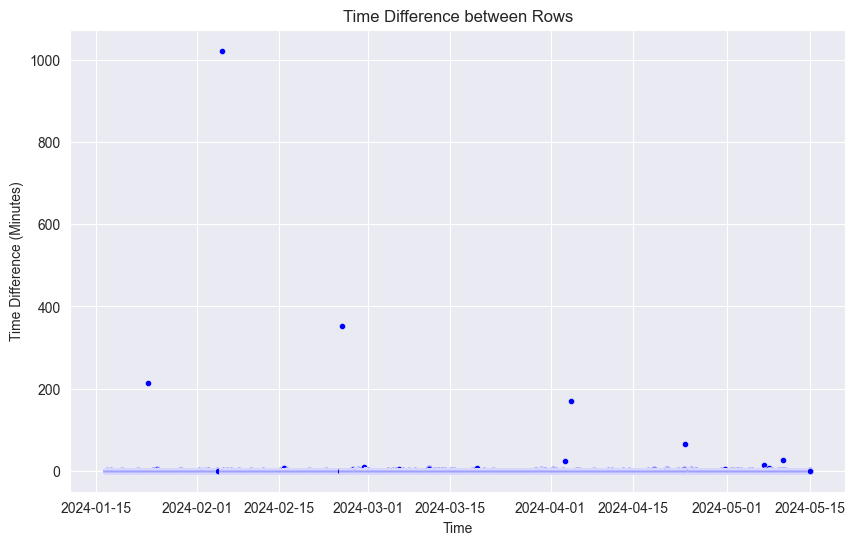

In [18]:
# Create the scatter plot using Seaborn
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df.index, y=df['time-diff-minutes'], color='blue', s=20)

# Adding labels and title
plt.xlabel('Time')
plt.ylabel('Time Difference (Minutes)')
plt.title('Time Difference between Rows')
plt.grid(True)
plt.show()

In [19]:
irregular_timesteps = df[(df['time-diff-minutes'] < 1.0)]
# Reset the index to include it as a column
irregular_timesteps_reset = irregular_timesteps.reset_index()
# Display the relevant columns
irregular_timesteps_reset[["time", "time-diff-minutes"]]

,time,time-diff-minutes
0,2024-01-16 13:13:30+07:00,0.5
1,2024-01-17 09:42:30+07:00,0.5
2,2024-01-19 07:35:30+07:00,0.5
3,2024-01-24 12:49:30+07:00,0.5
4,2024-01-24 12:59:00+07:00,0.5
...,...,...
419,2024-05-09 14:04:30+07:00,0.5
420,2024-05-10 06:32:30+07:00,0.5
421,2024-05-10 09:01:30+07:00,0.5
422,2024-05-10 10:59:30+07:00,0.5


In [20]:
irregular_timesteps = df[(df['time-diff-minutes'] > 1.0)]
# Reset the index to include it as a column
irregular_timesteps_reset = irregular_timesteps.reset_index()
# Display the relevant columns
irregular_timesteps_reset[["time", "time-diff-minutes"]]

,time,time-diff-minutes
0,2024-01-16 19:17:30+07:00,2.0
1,2024-01-17 09:42:00+07:00,1.5
2,2024-01-19 07:35:00+07:00,1.5
3,2024-01-22 01:32:30+07:00,3.0
4,2024-01-23 17:01:30+07:00,215.0
...,...,...
628,2024-05-10 09:01:00+07:00,1.5
629,2024-05-10 10:59:00+07:00,1.5
630,2024-05-10 11:55:30+07:00,26.0
631,2024-05-10 19:42:00+07:00,1.5


In [21]:
irregular_timesteps = df[(df['time-diff-minutes'] > 1.0) & (df['time-diff-minutes'] < 5.0)]
# Reset the index to include it as a column
irregular_timesteps_reset = irregular_timesteps.reset_index()
# Display the relevant columns
irregular_timesteps_reset[["time", "time-diff-minutes"]]

,time,time-diff-minutes
0,2024-01-16 19:17:30+07:00,2.0
1,2024-01-17 09:42:00+07:00,1.5
2,2024-01-19 07:35:00+07:00,1.5
3,2024-01-22 01:32:30+07:00,3.0
4,2024-01-24 12:49:00+07:00,1.5
...,...,...
608,2024-05-10 06:32:00+07:00,1.5
609,2024-05-10 09:01:00+07:00,1.5
610,2024-05-10 10:59:00+07:00,1.5
611,2024-05-10 19:42:00+07:00,1.5


In [22]:
irregular_timesteps = df[(df['time-diff-minutes'] > 5.0)]
# Reset the index to include it as a column
irregular_timesteps_reset = irregular_timesteps.reset_index()
# Display the relevant columns
irregular_timesteps_reset[["time", "time-diff-minutes"]]

,time,time-diff-minutes
0,2024-01-23 17:01:30+07:00,215.0
1,2024-02-05 08:41:30+07:00,1022.0
2,2024-02-15 19:38:30+07:00,6.0
3,2024-02-15 19:52:30+07:00,6.0
4,2024-02-25 15:08:00+07:00,352.5
5,2024-02-29 10:46:00+07:00,8.5
6,2024-03-11 08:21:00+07:00,6.0
7,2024-03-19 11:34:30+07:00,6.0
8,2024-04-03 10:12:30+07:00,23.0
9,2024-04-04 09:49:30+07:00,171.0


In [23]:
def plot_data_date(df, start_date="2024-05-19", end_date="2024-05-30", feature="condensor1_discharge_temp"):
    # Convert the start and end dates to UTC to match the DataFrame's index timezone
    start_date = pd.to_datetime(start_date, utc=True)
    end_date = pd.to_datetime(end_date, utc=True)

    # Filter the DataFrame by date range
    df_filtered = df.loc[start_date:end_date]

    # Plot the data
    plt.figure(figsize=(15, 7))
    plt.plot(df_filtered.index, df_filtered[feature], color="salmon", label=feature)
    plt.scatter(df_filtered.index, df_filtered[feature], color="red")

    # Add daily boundaries
    for day in pd.date_range(start=start_date, end=end_date, freq='D'):
        plt.axvline(x=day, color='gray', linestyle='--', alpha=0.7, linewidth=0.5)

    # Plot the mean line
    plt.axhline(y=df_filtered[feature].mean(), color='b', linestyle='--', label=f'{feature} Mean')

    # Title, labels, and legend
    plt.title(f"{feature} from {start_date.date()} to {end_date.date()}")
    plt.xlabel("Time")
    plt.ylabel("Value")
    plt.xticks(rotation=45)
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

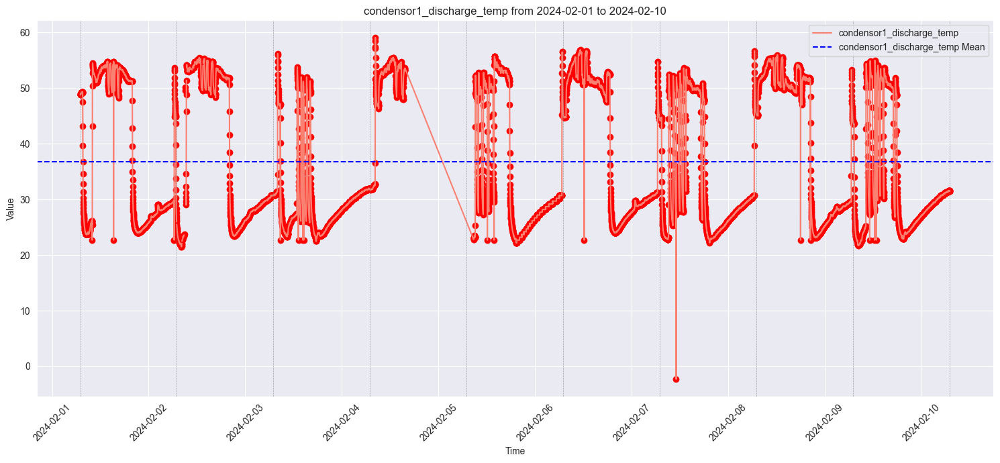

In [24]:
plot_data_date(df, start_date="2024-02-01", end_date="2024-02-10", feature="condensor1_discharge_temp")

<Axes: xlabel='time'>

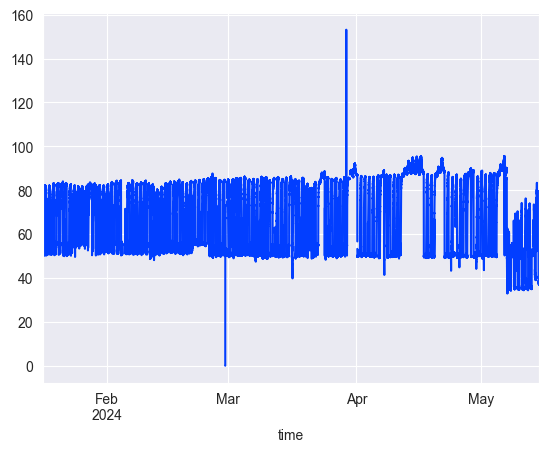

In [25]:
df.compressor1_suction_pressure.resample('1T').mean().plot()

<Axes: xlabel='time'>

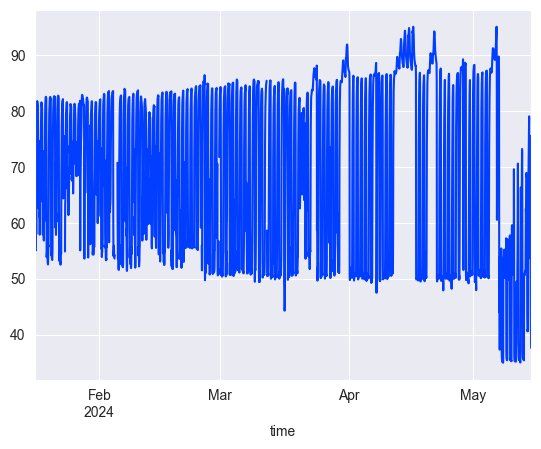

In [26]:
df.compressor1_suction_pressure.resample('1H').mean().plot()

<Axes: xlabel='time'>

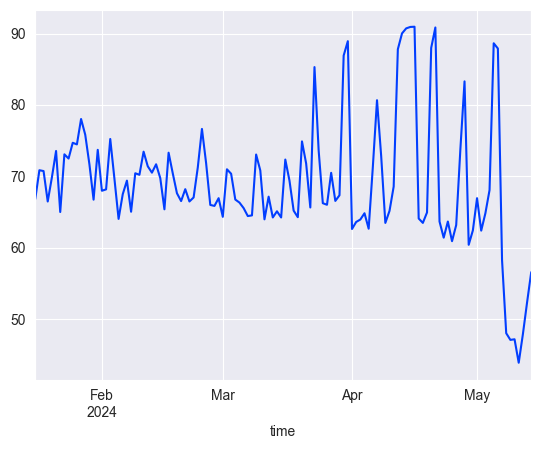

In [27]:
df.compressor1_suction_pressure.resample('D').mean().plot()

### Resampling to 1 minute intervals

**Downsampling**
- Definition: Reducing the frequency of data points. For example, converting data from a minute-level frequency to an hourly frequency.
- Example: Aggregating 1-minute data into hourly averages.
- Operation: Typically involves reducing the number of observations. Aggregation functions like mean, sum, or max are often used.
```python
df_downsampled = df.resample('1H').mean()
```

**Upsampling**
- Definition: Increasing the frequency of data points. For example, converting hourly data to minute-level data.
- Example: Filling gaps between hourly data points with minute-level timestamps.
- Operation: Typically involves adding new rows to the DataFrame and then filling or interpolating the missing values.
```python
df_upsampled = df.resample('1T').mean()
df_filled = df_upsampled.fillna(method='ffill')
```





In [28]:
# We will use the Upsampling because the sensor from MQTT send every 1 minute
df = df.resample('1T').mean()

In [29]:
# Reconvert the time differences to a pandas Timedelta object, specifying the unit as minutes
df['time-diff-minutes'] = df.index.to_series().diff().dt.total_seconds() / 60

In [30]:
# Count time steps that not equal to 1 minute
irregular_timesteps = df[(df['time-diff-minutes'] != 1.0)]
# Reset the index to include it as a column
irregular_timesteps_reset = irregular_timesteps.reset_index()
# Display the relevant columns
irregular_timesteps_reset[["time", "time-diff-minutes"]]

,time,time-diff-minutes
0,2024-01-16 13:13:00+07:00,NaN


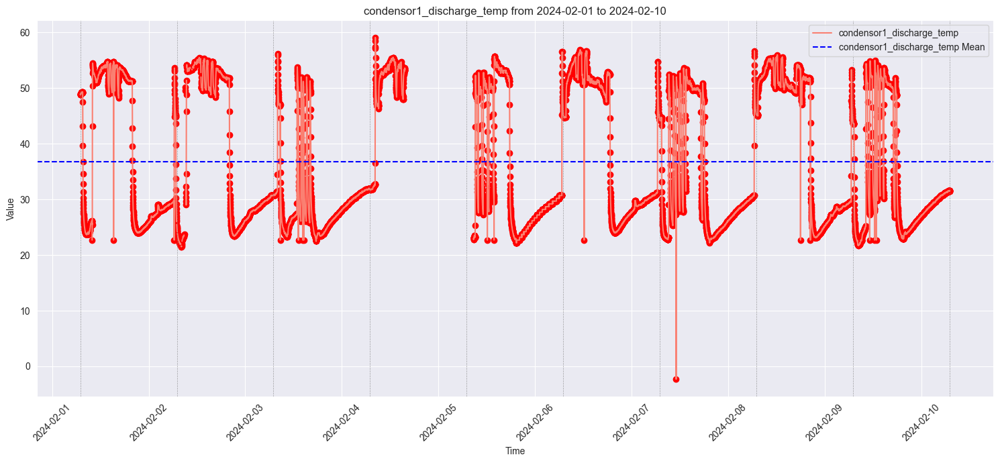

In [31]:
# See the resulted after apply Upsampling
plot_data_date(df, start_date="2024-02-01", end_date="2024-02-10", feature="condensor1_discharge_temp")

In [32]:
# Count nan values in each column
df.isnull().sum().reset_index()

,index,0
0,evaporator_airflow,3108
1,evaporator_motorfcu,3080
2,evaporator_eqv_current_indoor,3126
3,evaporator_supplyair,3081
4,ambient_temp_indoor,3107
5,evaporator_eqv_volt_indoor,3143
6,evaporator_return_temp,3084
7,ambient_humid_indoor,3120
8,condensor1_eqv_current_outdoor,3545
9,compressor1_suction_pressure,3555


In [33]:
import plotly.express as px

def plot_express(df, feature):
  fig = px.line(df, x=df.index, y=df[feature])
  fig.update_xaxes(
      rangeslider_visible=True,
      rangeselector=dict(
          buttons=list([
              dict(count=1, label="1m", step="month", stepmode="backward"),
              dict(count=6, label="6m", step="month", stepmode="backward"),
          ])
      )
  )
  fig.show()

In [34]:
plot_express(df, feature="condensor1_discharge_temp")

# for feature in columns_list:
#     plot_express(df, feature)

### Handling missing values with Interpolation

In [35]:
def visual_error_range(df, start_date='2024-01-16', end_date='2024-06-01', feature=None):

    # Ensure the start and end dates are in the same timezone as the DataFrame index
    start_date = pd.to_datetime(start_date, utc=True)
    end_date = pd.to_datetime(end_date, utc=True)

    # Filter the DataFrame by the date range
    df_filtered = df.loc[start_date:end_date]

    # Plotting each sensor in a separate subplot with missing values highlighted
    plt.figure(figsize=(25, 30))
    for i, column in enumerate(feature, 1):
        
        plt.subplot(len(feature), 1, i)
        plt.plot(df_filtered.index, df_filtered[column], label=column)
        
        # Highlight missing values
        missing = df_filtered[df_filtered[column].isna()]
        if not missing.empty:
            plt.scatter(missing.index, [df_filtered[column].min()]*len(missing), 
                        color='red', label='Missing Values', marker='x', s=50)
        
        plt.xlabel('Time')
        plt.ylabel(column)
        plt.title(f'Time Series Plot for {column}')
        plt.legend()


    plt.tight_layout()
    plt.show()

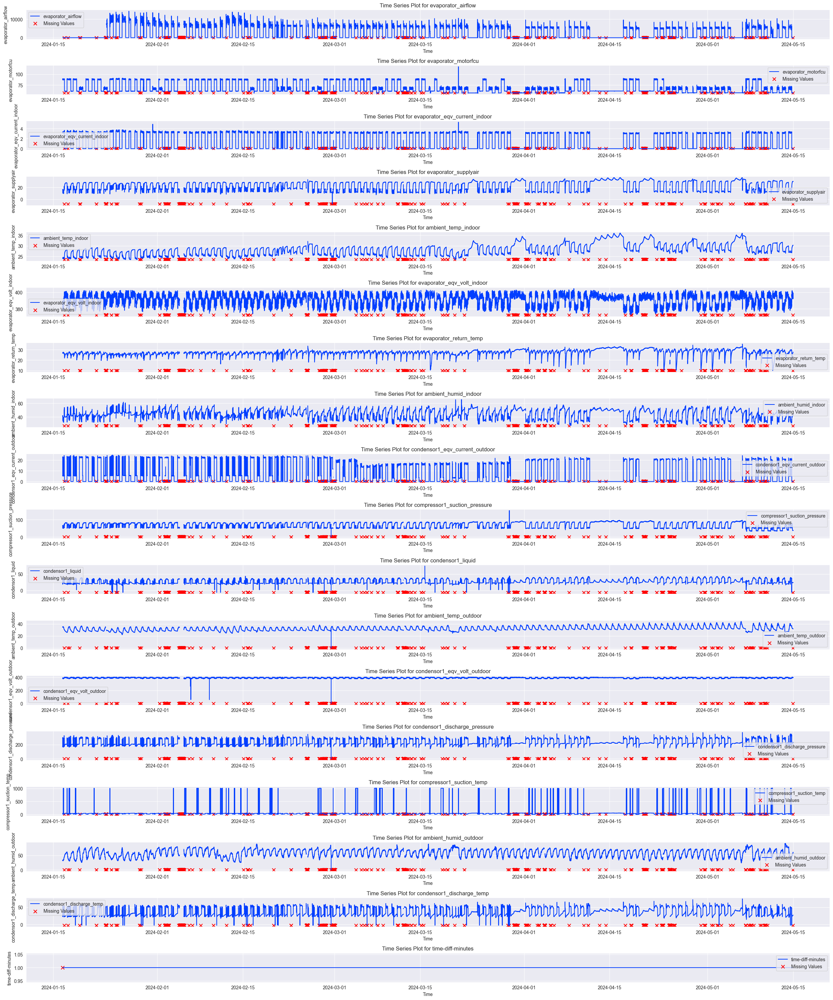

In [36]:
columns_list = [col for col in df.columns if col not in ['time-diff-minute']]

visual_error_range(df=df, feature=columns_list)

To handle missing values after resampling, you have several options depending on how you want to impute or fill in the gaps. Here are some common methods:

Forward Fill (Propagate Last Value)
- This method propagates the last valid observation forward to fill in missing values.
```python
df = df.resample('1T').mean().fillna(method='ffill')
```

Backward Fill (Propagate Next Value)
- This method propagates the next valid observation backward to fill in missing values.
```python
df = df.resample('1T').mean().fillna(method='bfill')
```

Interpolate (Linear Interpolation)
- This method estimates missing values using linear interpolation between existing values.
```python
df = df.resample('1T').mean().interpolate(method='linear')
```

Fill with a Specific Value
- You can fill missing values with a specific constant value, such as zero or the mean of the column.
```python
df = df.resample('1T').mean().fillna(0)  # Fill with zero
# or
df = df.resample('1T').mean().fillna(df['compressor1_suction_pressure'].mean())  # Fill with column mean
```

Use a Combination of Methods
- Sometimes you may want to use a combination of methods, such as forward fill followed by interpolation.
```python
df = df.resample('1T').mean()
df = df.fillna(method='ffill').interpolate(method='linear')
```



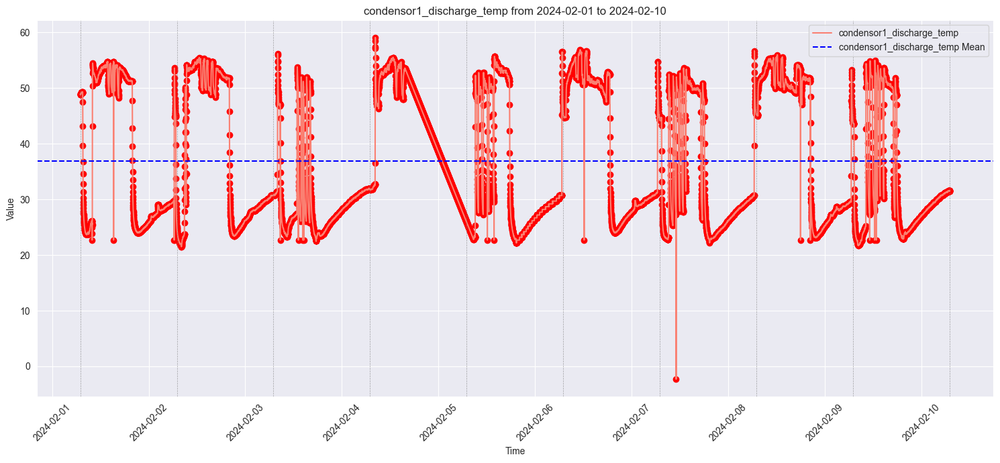

In [37]:
# Lets Experiments with Interpolation
df_test = df.interpolate(method='linear', limit_direction='both')

# See the resulted
plot_data_date(df_test, start_date="2024-02-01", end_date="2024-02-10", feature="condensor1_discharge_temp")

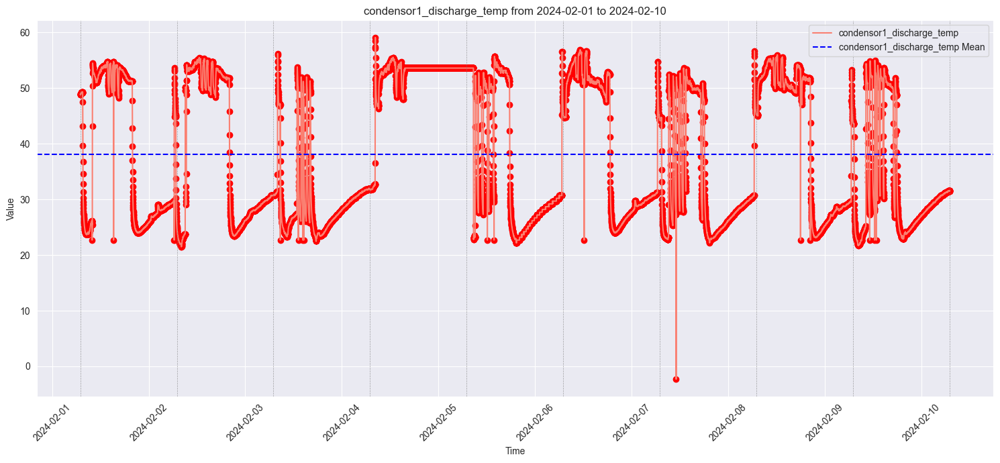

In [38]:
# Lets Experiments with Forward Fill
df_test = df.fillna(method='ffill')  # Forward fill missing values

# See the resulted
plot_data_date(df_test, start_date="2024-02-01", end_date="2024-02-10", feature="condensor1_discharge_temp")

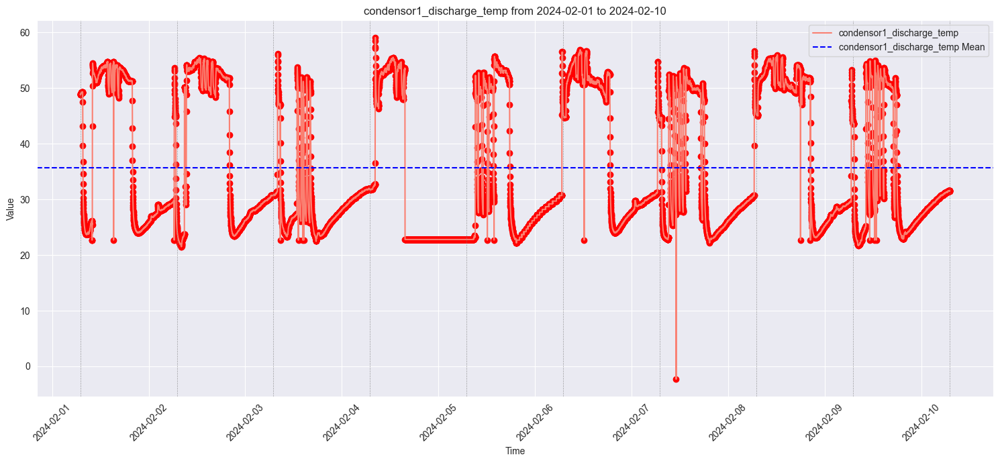

In [39]:
# Lets Experiments with Backwardfill
df_test = df.fillna(method='bfill')  # Forward fill missing values

# See the resulted 
plot_data_date(df_test, start_date="2024-02-01", end_date="2024-02-10", feature="condensor1_discharge_temp")

In this project we will use Interpolation to handle missing value

In [40]:
# Lets Experiments with Interpolation
df = df.interpolate(method='linear', limit_direction='both')

In [41]:
# Count nan values in each column
df.isnull().sum().reset_index()

,index,0
0,evaporator_airflow,0
1,evaporator_motorfcu,0
2,evaporator_eqv_current_indoor,0
3,evaporator_supplyair,0
4,ambient_temp_indoor,0
5,evaporator_eqv_volt_indoor,0
6,evaporator_return_temp,0
7,ambient_humid_indoor,0
8,condensor1_eqv_current_outdoor,0
9,compressor1_suction_pressure,0


## Handling Outlier

### Create function to plotting and remove outlier

In [42]:

def plot_statistical_graphs(df, features, title, figsize=(15, 12)):
    """
    Plot time series, distribution, and combined boxplot + violin plot with statistical annotations.

    Args:
        df (pd.DataFrame): DataFrame containing the data.
        features (list): List of feature names (columns) to be plotted.
        title (str): Title for the plots.
        figsize (tuple): Size of the figure for the plots.

    Returns:
        None
    """
    
    print(df[features].describe().T)

    # Create a figure with three subplots
    fig, axes = plt.subplots(nrows=3, ncols=1, figsize=figsize)

    # 1. Time Series Plot
    df[features].plot(ax=axes[0], title=f"{title} Time Series")
    axes[0].set_ylabel('Values')
    axes[0].set_xlabel('Time')


    # 2. Distribution Plot
    sns.histplot(data=df[features], kde=True, common_norm=True, stat='density', 
                 bins=50, ax=axes[1])
    axes[1].set_title(f"{title} Distribution")
    axes[1].set_xlabel('Values')
    axes[1].set_ylabel('Density')

    # 3. Combined Boxplot + Violin Plot with Annotations
    sns.violinplot(data=df[features], color='lightblue', inner=None, ax=axes[2])
    sns.boxplot(data=df[features], width=0.3, whis=1.5, showfliers=True, 
                showcaps=True, boxprops={'facecolor':'blue', 'alpha':0.6}, ax=axes[2])
    
    axes[2].set_title(f"{title} Boxplot + Violin Plot")
    axes[2].set_xlabel('Features')
    axes[2].set_ylabel('Values')

    # Annotating the Boxplot with statistical information
    for i, feature in enumerate(features):
        data = df[feature]
        quartiles = data.quantile([0.25, 0.5, 0.75])
        median = quartiles[0.5]
        q1 = quartiles[0.25]
        q3 = quartiles[0.75]
        iqr = q3 - q1
        min_val = max(data.min(), q1 - 1.5 * iqr)
        max_val = min(data.max(), q3 + 1.5 * iqr)
        mean_val = data.mean()

        # Adjust positions of the annotations to the side of the boxplot
        axes[2].annotate(f'Median: {median:.2f}\nMean: {mean_val:.2f}', xy=(i, median), xytext=(i + 0.25, median),
                         arrowprops=dict(facecolor='blue', arrowstyle='->', lw=1.5), fontsize=7, color='blue')
        
        axes[2].annotate(f'Q1: {q1:.2f}', xy=(i, q1), xytext=(i + 0.25, q1), 
                         arrowprops=dict(facecolor='black', arrowstyle='->', lw=1.5), fontsize=7, color='black')
        
        axes[2].annotate(f'Q3: {q3:.2f}', xy=(i, q3), xytext=(i + 0.25, q3), 
                         arrowprops=dict(facecolor='black', arrowstyle='->', lw=1.5), fontsize=7, color='black')
        
        axes[2].annotate(f'Min: {min_val:.2f}', xy=(i, min_val), xytext=(i + 0.25, min_val), 
                         arrowprops=dict(facecolor='black', arrowstyle='->', lw=1.5), fontsize=7, color='black')
        
        axes[2].annotate(f'Max: {max_val:.2f}', xy=(i, max_val), xytext=(i + 0.25, max_val), 
                         arrowprops=dict(facecolor='black', arrowstyle='->', lw=1.5), fontsize=7, color='black')
        
        # Highlight outliers
        # outliers = data[(data < min_val) | (data > max_val)]
        # for outlier in outliers:
        #     axes[2].annotate(f'{outlier:.2f}', xy=(i, outlier), xytext=(i + 0.25, outlier), 
        #                     arrowprops=dict(facecolor='red', arrowstyle='->', lw=1.5), fontsize=7, color='red')
        

    # Adjust layout
    plt.tight_layout()
    plt.show()

In [43]:
def remove_outlier(df, threshold, feature, condition: str):
    """
    Removes outliers from a DataFrame based on a threshold and fills missing values using the specified method.

    Args:
        df (pd.DataFrame): DataFrame containing the data.
        threshold (float): Threshold value to identify outliers.
        feature (str): The feature (column) to check for outliers.
        condition (str): The condition for filling missing values. 
                         Options are 'ffill', 'bfill', 'interpolation'.

    Returns:
        None
    """
    
    # Applying the condition and handling missing values
    if condition == 'ffill':
        df.loc[df[feature] > threshold, feature] = np.nan
        df[feature].ffill(inplace=True)
        print("Forward fill applied")
        
    elif condition == 'bfill':
        df.loc[df[feature] < threshold, feature] = np.nan
        df[feature].bfill(inplace=True)
        print("Backward fill applied")
    
    elif condition == 'interpolation':
        df.loc[df[feature] > threshold, feature] = np.nan
        df[feature].interpolate(method='linear', inplace=True)
        print("Linear interpolation applied")
        
    else:
        raise ValueError("Invalid condition. Please use 'ffill', 'bfill', or 'interpolation'.")

### Detect and Fill Outlier

When it comes to detecting outliers effectively, boxplots and violin plots are particularly useful. Here's why:

1. Boxplot:
- Purpose: Boxplots are excellent for identifying outliers in your data. They display the distribution of data based on five summary statistics: minimum, first quartile (Q1), median, third quartile (Q3), and maximum. Points that fall below Q1 - 1.5 * IQR (Interquartile Range) or above Q3 + 1.5 * IQR are considered outliers and are marked as individual points.
- How to Identify Outliers: In a boxplot, outliers are shown as individual dots or asterisks outside the "whiskers" (lines extending from the box). These outliers are data points that lie beyond the typical range of the data. The farther away a point is from the whiskers, the more extreme the outlier is.
Example Insight: If you notice several outliers far above or below the whiskers, it might indicate measurement errors, unusual events, or potential data points that need further investigation.
2. Violin Plot:
- Purpose: Violin plots combine the features of a boxplot with a kernel density plot. They provide insight into the distribution and density of the data. While not specifically designed for outlier detection, violin plots help you see the overall distribution of the data, including any unusual peaks or gaps that could indicate outliers.
- How to Identify Outliers: Look for areas where the distribution tails off sharply or has unusual spikes. These could be indicative of outliers or anomalies in the data.
Example Insight: If the distribution in the violin plot is mostly smooth but has an unexpected peak at an extreme value, it may suggest an outlier.

In [44]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 172007 entries, 2024-01-16 13:13:00+07:00 to 2024-05-14 23:59:00+07:00
Freq: T
Data columns (total 18 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   evaporator_airflow              172007 non-null  float64
 1   evaporator_motorfcu             172007 non-null  float64
 2   evaporator_eqv_current_indoor   172007 non-null  float64
 3   evaporator_supplyair            172007 non-null  float64
 4   ambient_temp_indoor             172007 non-null  float64
 5   evaporator_eqv_volt_indoor      172007 non-null  float64
 6   evaporator_return_temp          172007 non-null  float64
 7   ambient_humid_indoor            172007 non-null  float64
 8   condensor1_eqv_current_outdoor  172007 non-null  float64
 9   compressor1_suction_pressure    172007 non-null  float64
 10  condensor1_liquid               172007 non-null  float64
 11  ambient_temp_outdoor    

![AirSystem](external\predictive-maintenance-forecast-anomaly.png) 

#### 1. evaporator_airflow

From Domain Knowledge :
- Information that have given by expertise said the normal range will be on 6000~12000 CMH
- Typical target air flow rates are approximately 350 - 450 cubic feet per minute per ton (47.0 - 60.5 L/S per kW) of cooling capacity.can convert to  from https://www.researchgate.net/publication/279691120_Impact_of_evaporator_coil_airflow_in_residential_air-conditioning_systems#:~:text=Sufficient%20airflow%20is%20necessary%20to,sensible%20and%20latent%20cooling%20capacity.

                       count         mean          std  min  25%  50%     75%  \
evaporator_airflow  172007.0  2778.101042  3321.166074  0.0  0.0  0.0  6084.0   

                        max  
evaporator_airflow  14297.4  


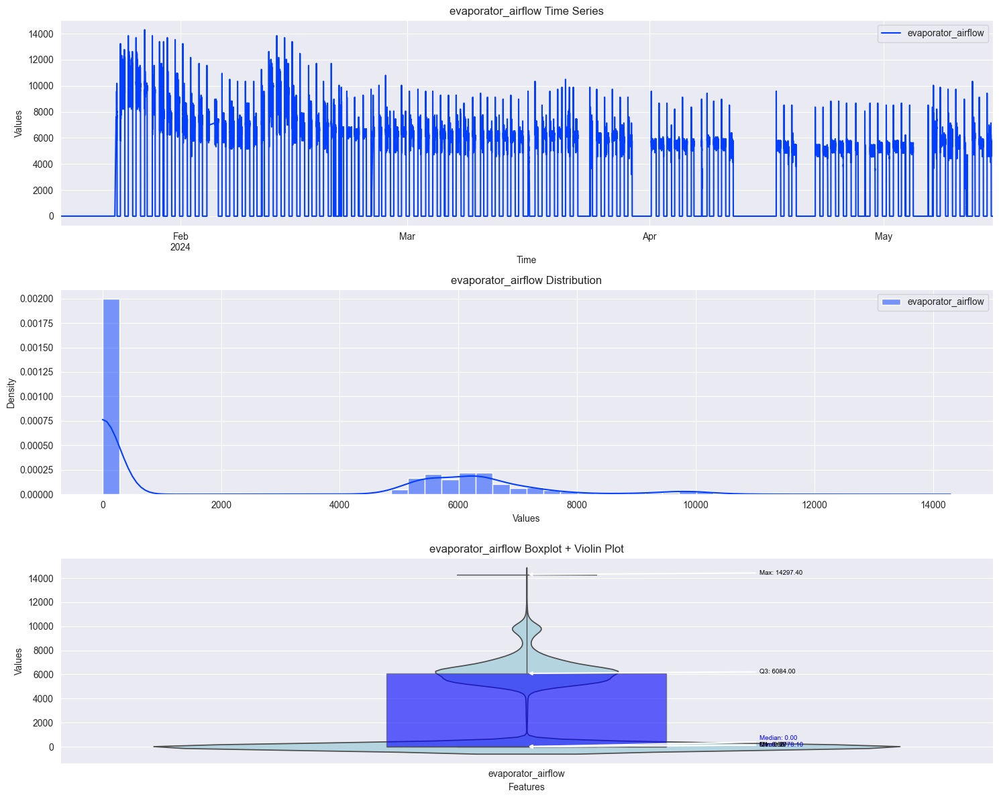

In [45]:
features = ['evaporator_airflow']
title = 'evaporator_airflow'
plot_statistical_graphs(df=df, features=features, title=title)

#### 2. evaporator_motorfcu x


                        count       mean        std   min   25%   50%   75%  \
evaporator_motorfcu  172007.0  68.639486  11.822729  56.6  61.1  61.5  87.0   

                       max  
evaporator_motorfcu  117.3  


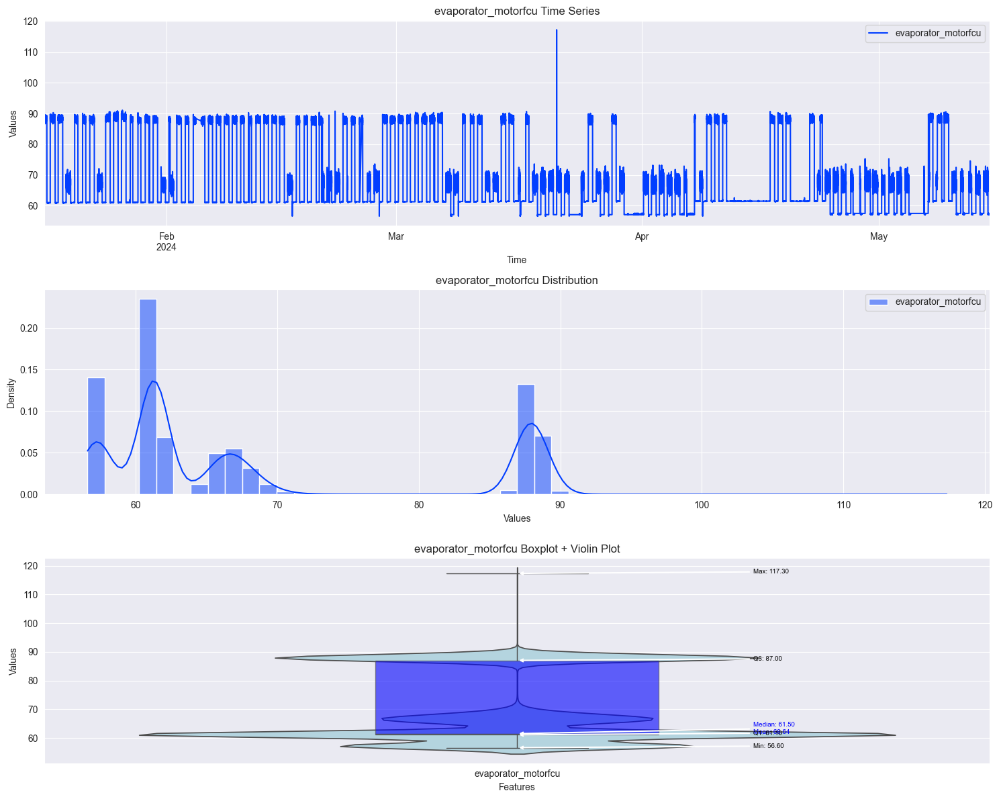

In [46]:
features = ['evaporator_motorfcu']
title = 'evaporator_motorfcu'
plot_statistical_graphs(df=df, features=features, title=title)

Forward fill applied
                        count       mean        std   min   25%   50%   75%  \
evaporator_motorfcu  172007.0  68.639136  11.822179  56.6  61.1  61.5  87.0   

                      max  
evaporator_motorfcu  91.1  


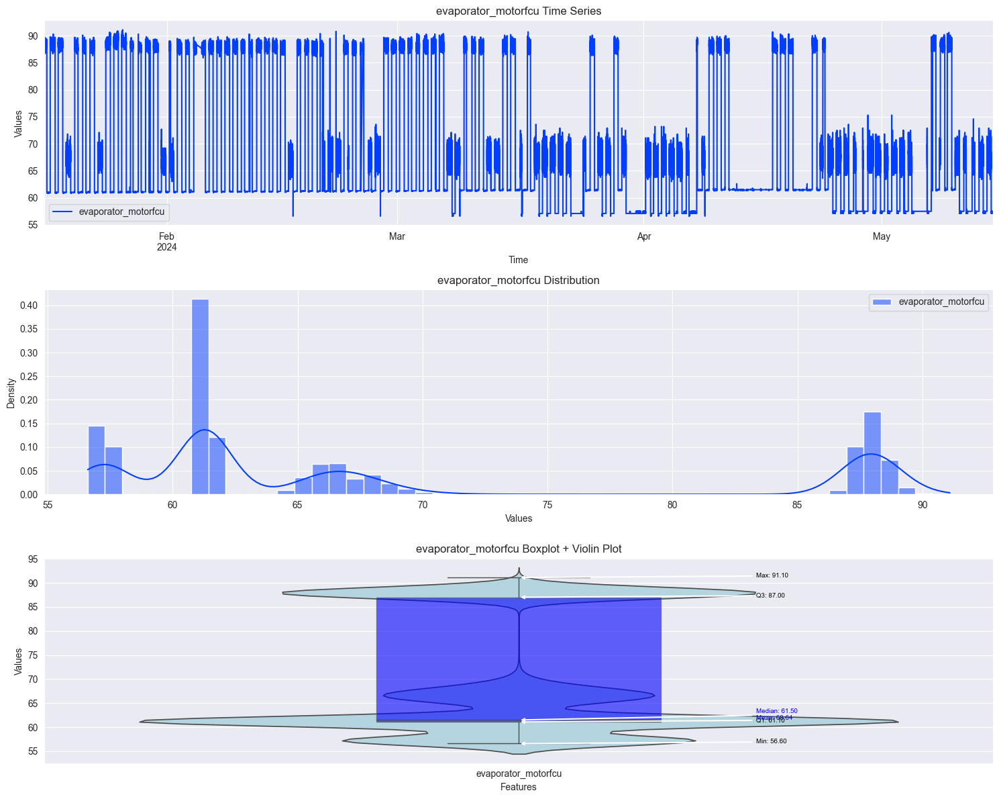

In [47]:
features = ['evaporator_motorfcu']
title = 'evaporator_motorfcu'
feature = 'evaporator_motorfcu'

remove_outlier(df=df, threshold=100, feature=feature, condition='ffill')
plot_statistical_graphs(df=df, features=features, title=title)

#### 3. evaporator_eqv_current_indoor

                                  count      mean       std  min  25%  50%  \
evaporator_eqv_current_indoor  172007.0  1.483289  1.609151  0.0  0.0  0.0   

                                75%  max  
evaporator_eqv_current_indoor  3.19  5.3  


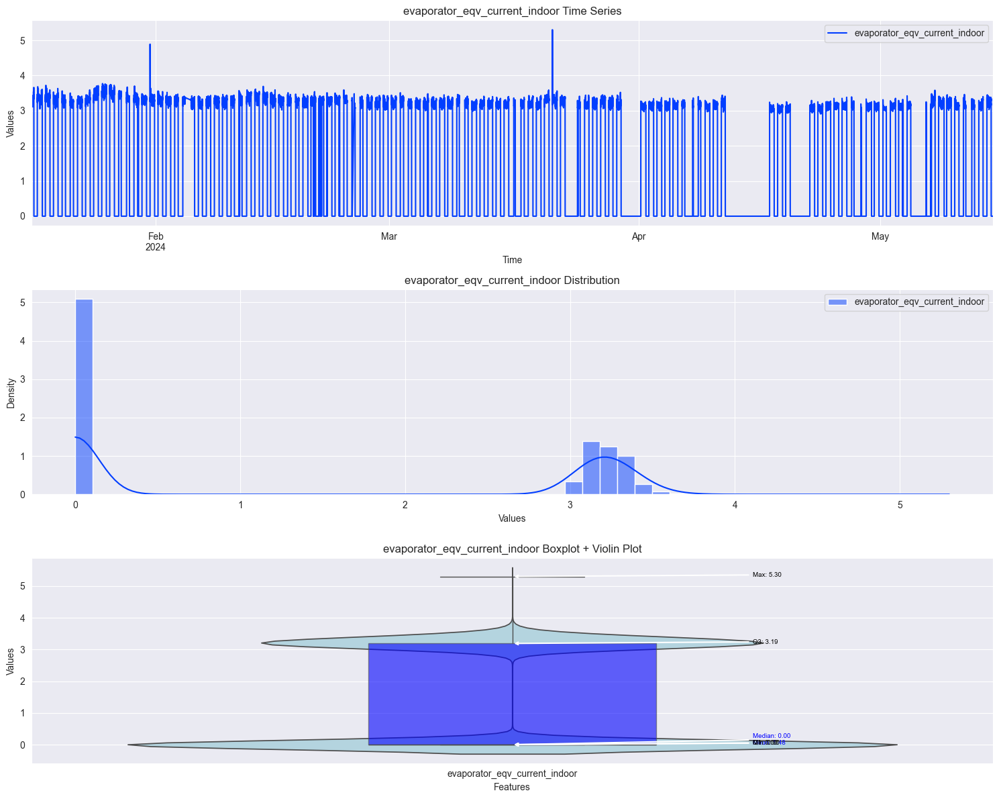

In [48]:
features = ['evaporator_eqv_current_indoor']
title = 'evaporator_eqv_current_indoor'
plot_statistical_graphs(df=df, features=features, title=title)

#### 4. evaporator_eqv_volt_indoor

                               count        mean       std     min     25%  \
evaporator_eqv_volt_indoor  172007.0  391.329606  6.631899  372.46  385.24   

                               50%     75%    max  
evaporator_eqv_volt_indoor  393.61  396.96  404.5  


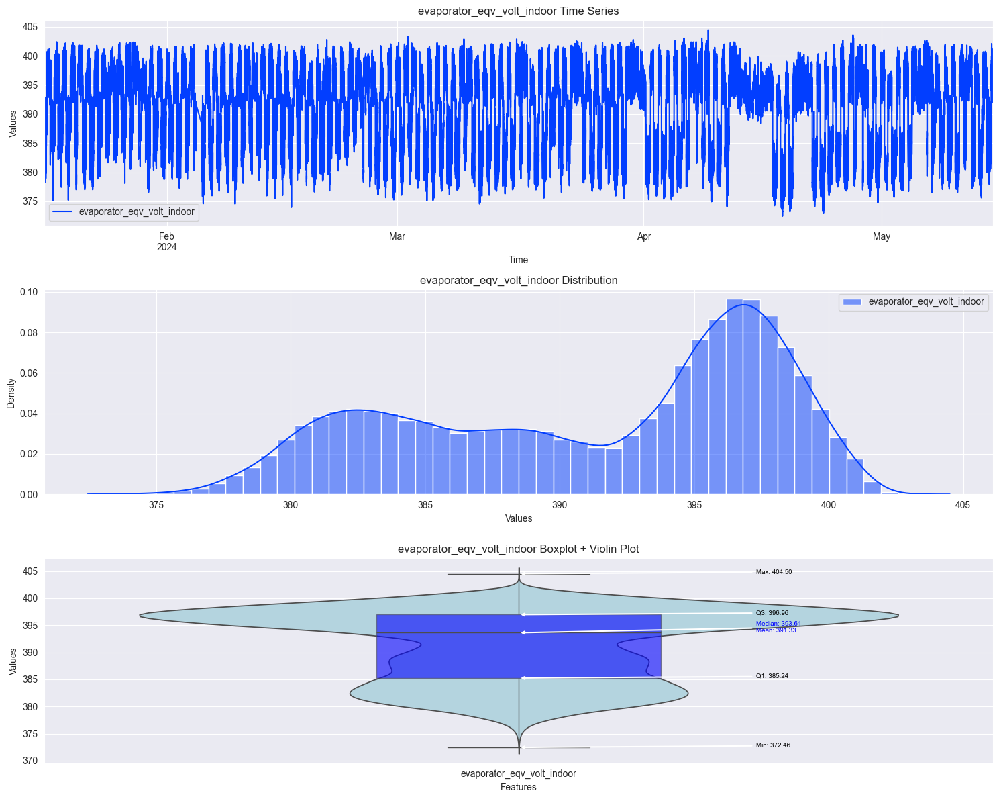

In [49]:
features = ['evaporator_eqv_volt_indoor']
title = 'evaporator_eqv_volt_indoor'
plot_statistical_graphs(df=df, features=features, title=title)

#### 5. evaporator_supplyair x

                         count       mean       std  min   25%   50%   75%  \
evaporator_supplyair  172007.0  22.541825  7.880089 -8.2  14.1  25.6  29.2   

                       max  
evaporator_supplyair  36.8  


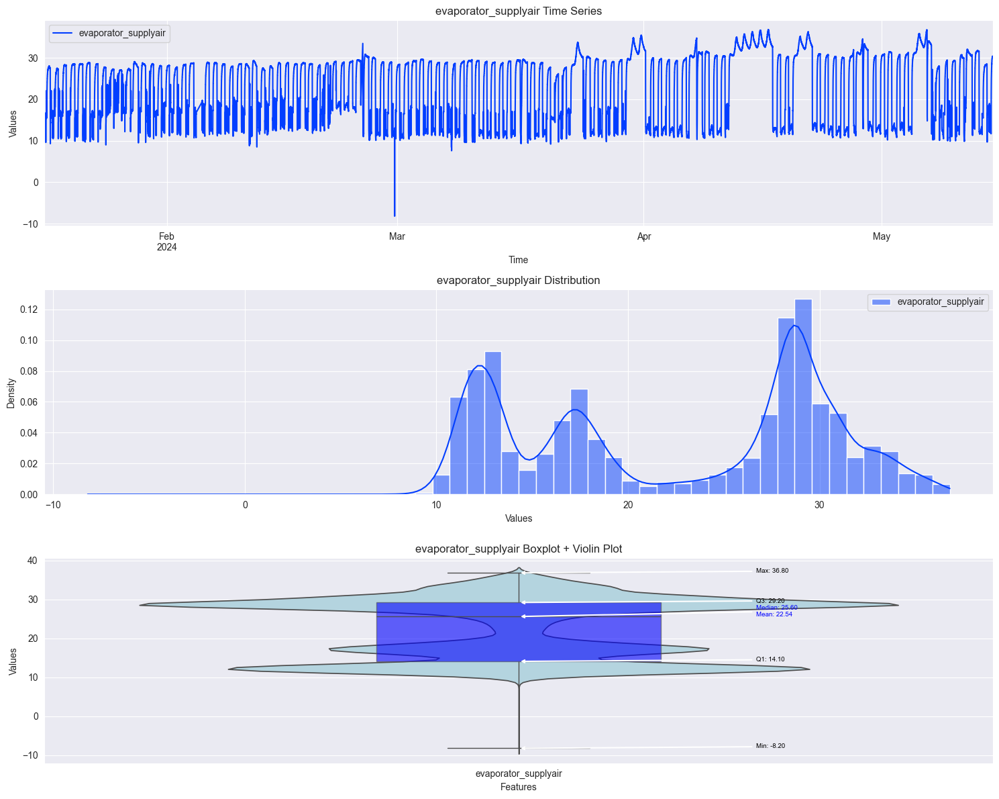

In [50]:
features = ['evaporator_supplyair']
title = 'evaporator_supplyair'
plot_statistical_graphs(df=df, features=features, title=title)

Backward fill applied
                         count       mean       std  min   25%   50%   75%  \
evaporator_supplyair  172007.0  22.542058  7.879478  7.6  14.1  25.6  29.2   

                       max  
evaporator_supplyair  36.8  


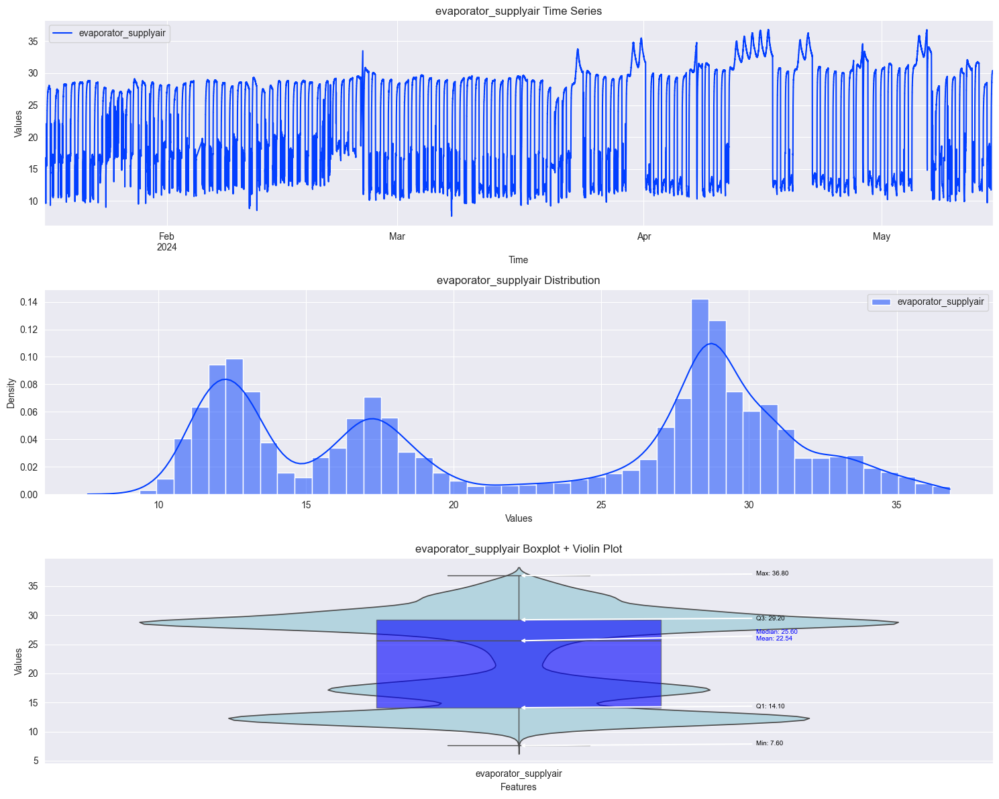

In [51]:
features = ['evaporator_supplyair']
title = 'evaporator_supplyair'
feature = 'evaporator_supplyair'

remove_outlier(df=df, threshold=0, feature=feature, condition='bfill')
plot_statistical_graphs(df=df, features=features, title=title)

#### 6. evaporator_return_temp

                           count       mean       std   min   25%   50%   75%  \
evaporator_return_temp  172007.0  27.186437  2.817265  10.0  26.1  27.3  28.7   

                         max  
evaporator_return_temp  35.4  


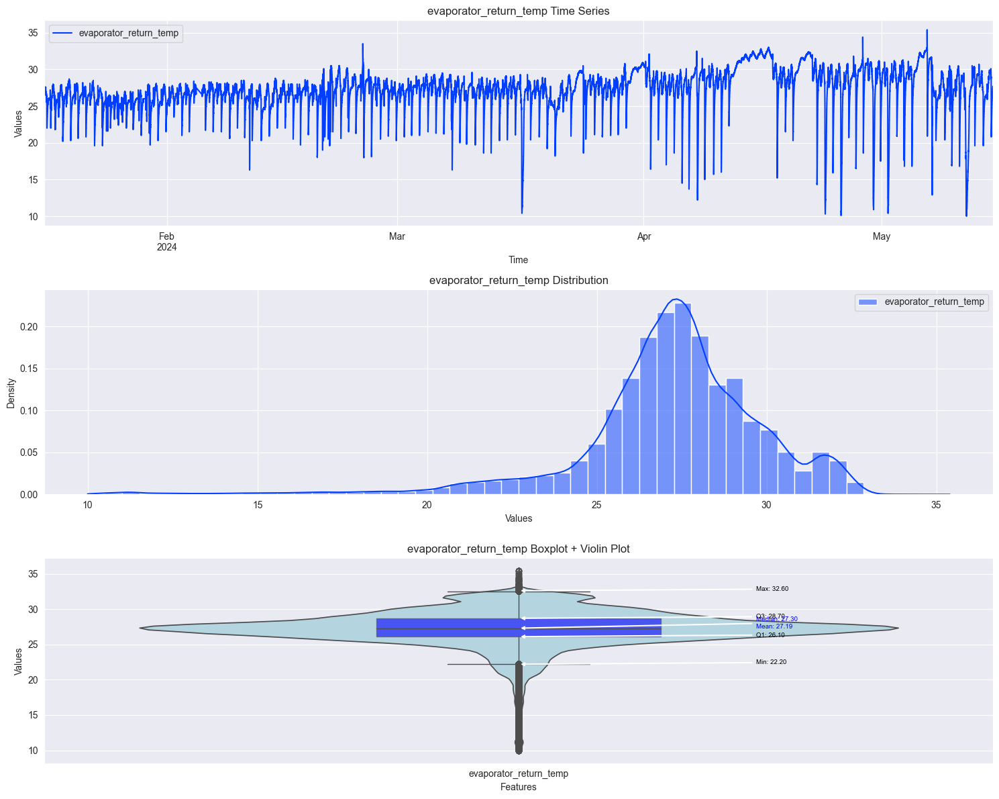

In [52]:
features = ['evaporator_return_temp']
title = 'evaporator_return_temp'
plot_statistical_graphs(df=df, features=features, title=title)

#### 1. ambient_temp_indoor

                        count       mean       std   min   25%   50%   75%  \
ambient_temp_indoor  172007.0  28.247545  2.698743  23.5  25.9  28.0  29.7   

                      max  
ambient_temp_indoor  36.0  


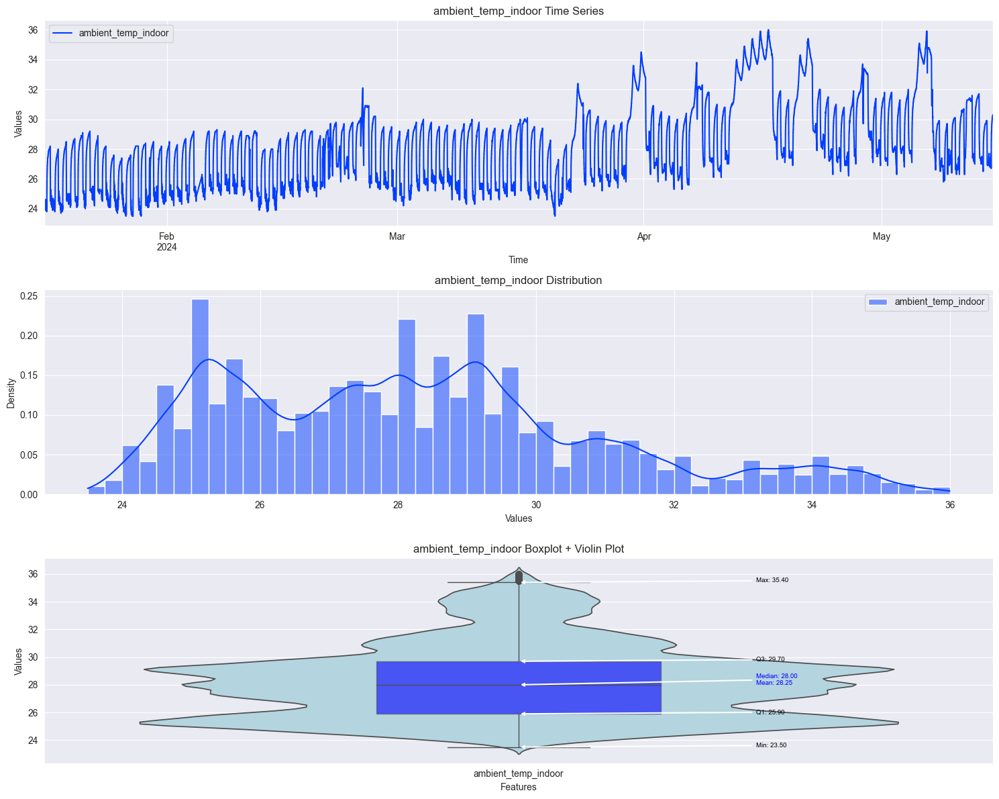

In [53]:
features = ['ambient_temp_indoor']
title = 'ambient_temp_indoor'
plot_statistical_graphs(df=df, features=features, title=title)

#### 2. ambient_temp_outdoor x

                         count      mean       std  min   25%   50%   75%  \
ambient_temp_outdoor  172007.0  31.95214  3.421572  0.0  29.4  31.3  34.4   

                       max  
ambient_temp_outdoor  44.0  


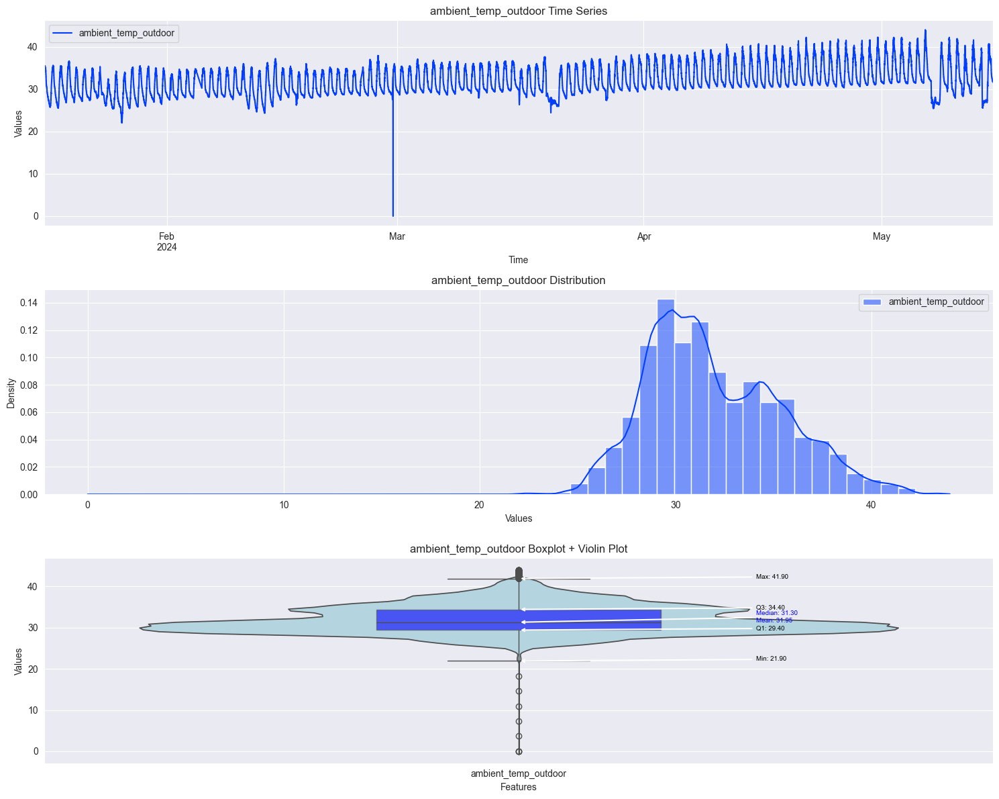

In [54]:
features = ['ambient_temp_outdoor']
title = 'ambient_temp_outdoor'
plot_statistical_graphs(df=df, features=features, title=title)

Backward fill applied
                         count       mean       std        min   25%   50%  \
ambient_temp_outdoor  172007.0  31.953374  3.416997  21.933333  29.4  31.3   

                       75%   max  
ambient_temp_outdoor  34.4  44.0  


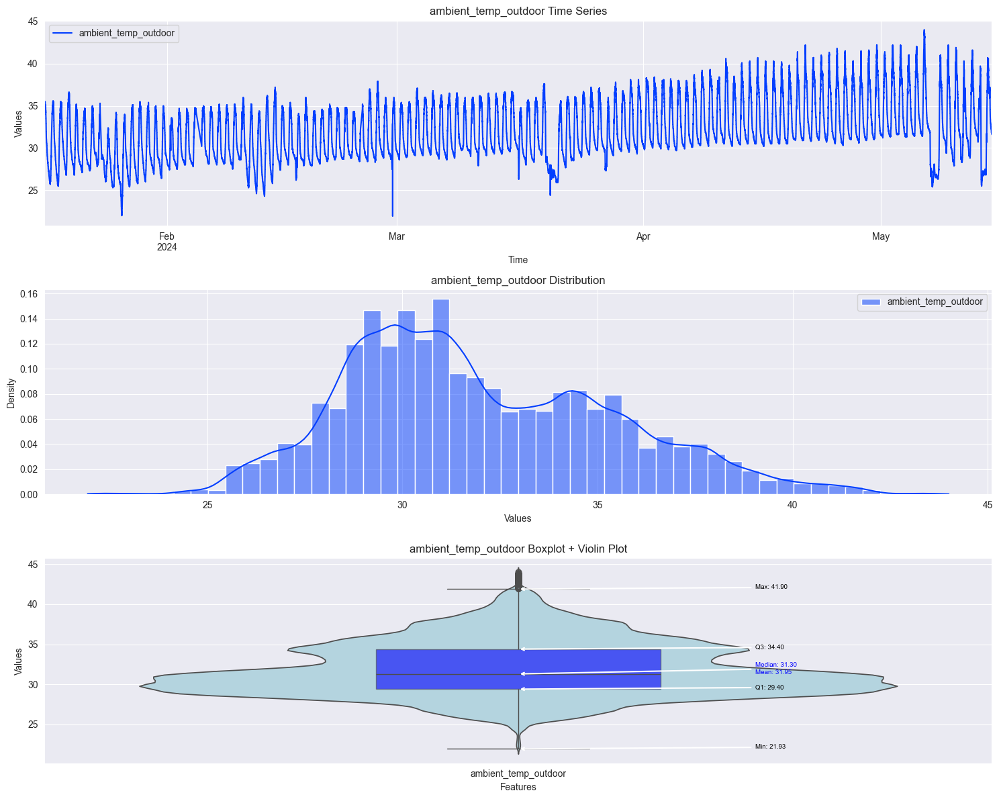

In [55]:
features = ['ambient_temp_outdoor']
title = 'ambient_temp_outdoor'
feature = 'ambient_temp_outdoor'

remove_outlier(df=df, threshold=20, feature=feature, condition='bfill')
plot_statistical_graphs(df=df, features=features, title=title)

#### 3. ambient_humid_indoor

                         count       mean      std   min   25%   50%   75%  \
ambient_humid_indoor  172007.0  43.941235  6.75676  26.8  38.1  44.6  49.7   

                       max  
ambient_humid_indoor  65.5  


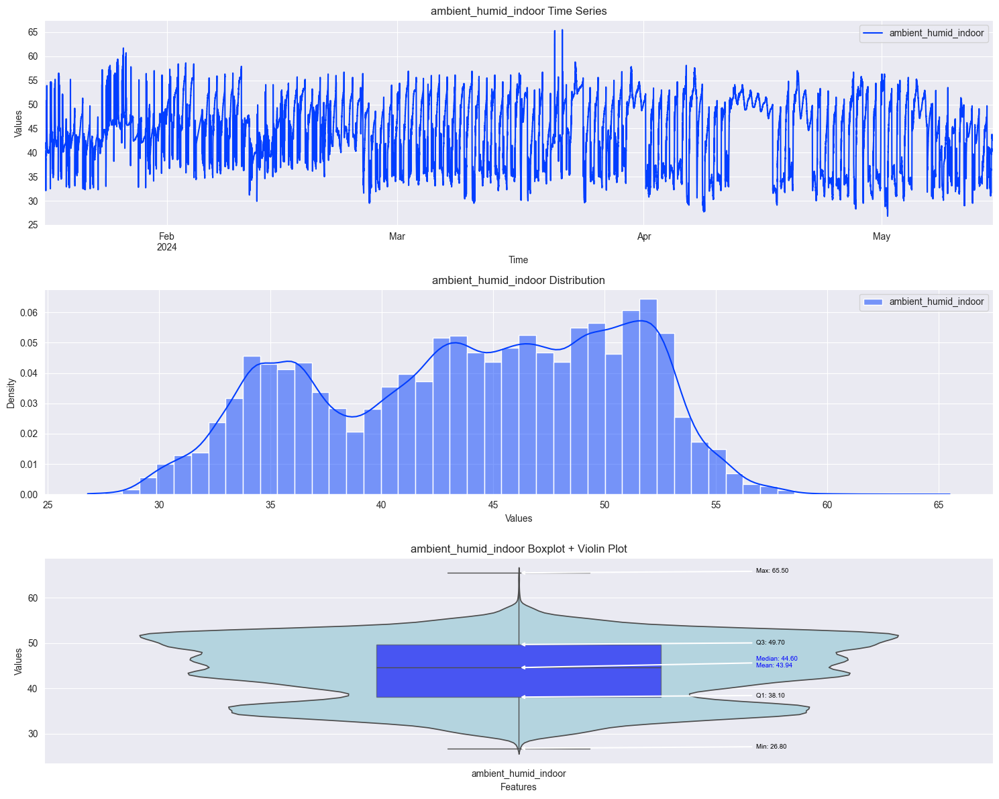

In [56]:
features = ['ambient_humid_indoor']
title = 'ambient_humid_indoor'
plot_statistical_graphs(df=df, features=features, title=title)

#### 4. ambient_humid_outdoor x

                          count       mean      std  min   25%   50%   75%  \
ambient_humid_outdoor  172007.0  58.270066  12.7941  0.0  47.5  60.2  69.1   

                        max  
ambient_humid_outdoor  91.2  


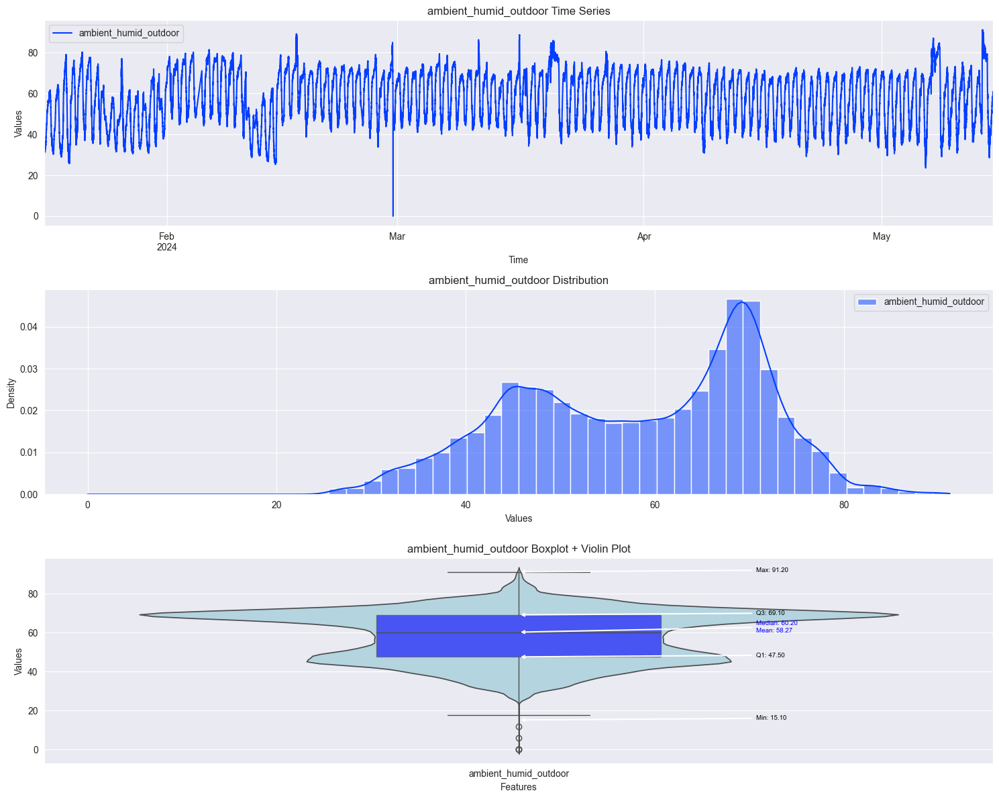

In [57]:
features = ['ambient_humid_outdoor']
title = 'ambient_humid_outdoor'
plot_statistical_graphs(df=df, features=features, title=title)

Backward fill applied
                          count       mean        std   min   25%   50%   75%  \
ambient_humid_outdoor  172007.0  58.271656  12.790363  23.6  47.5  60.2  69.1   

                        max  
ambient_humid_outdoor  91.2  


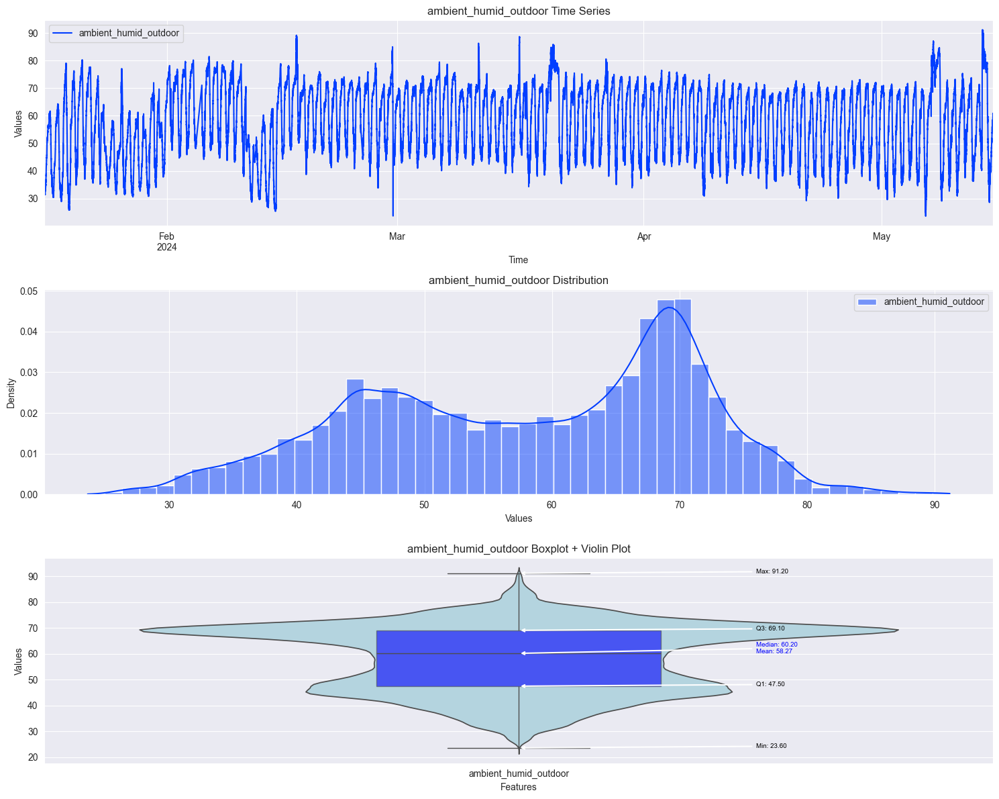

In [58]:
features = ['ambient_humid_outdoor']
title = 'ambient_humid_outdoor'
feature = 'ambient_humid_outdoor'

remove_outlier(df=df, threshold=20, feature=feature, condition='bfill')
plot_statistical_graphs(df=df, features=features, title=title)

#### 1. compressor1_suction_pressure x

                                 count       mean        std  min    25%  \
compressor1_suction_pressure  172007.0  69.111013  15.809834  0.0  51.81   

                                50%    75%     max  
compressor1_suction_pressure  72.67  83.58  153.16  


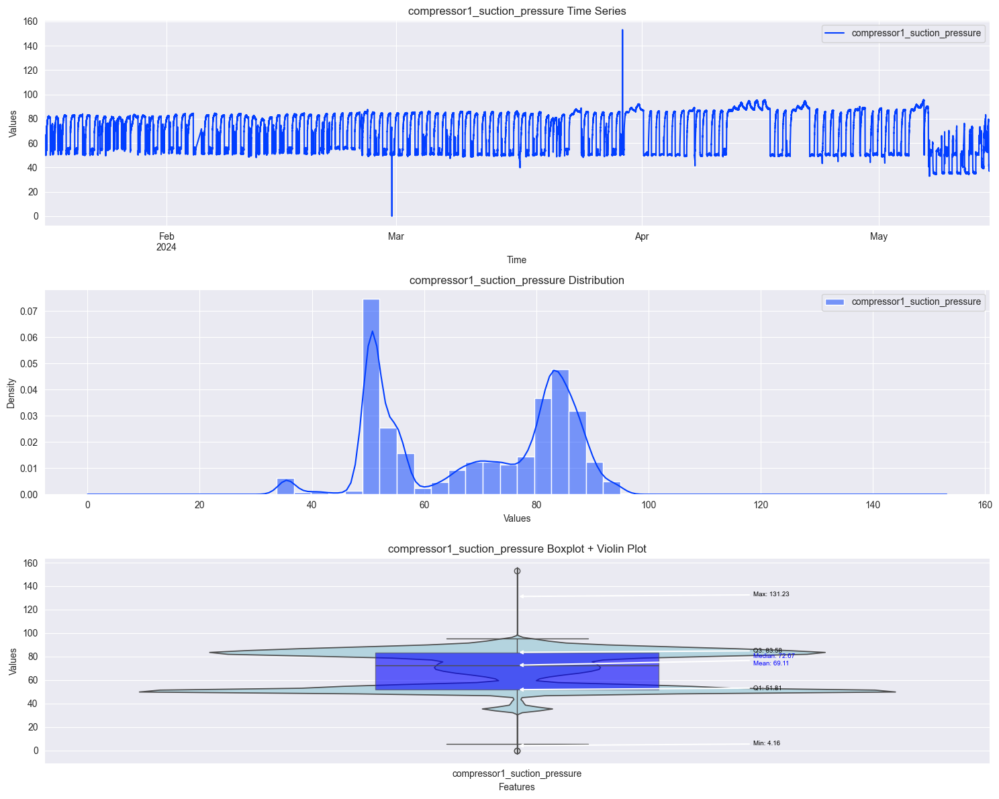

In [59]:
features = ['compressor1_suction_pressure']
title = 'compressor1_suction_pressure'
plot_statistical_graphs(df=df, features=features, title=title)

Forward fill applied
Backward fill applied
                                 count       mean        std  min    25%  \
compressor1_suction_pressure  172007.0  69.111013  15.809834  0.0  51.81   

                                50%    75%     max  
compressor1_suction_pressure  72.67  83.58  153.16  


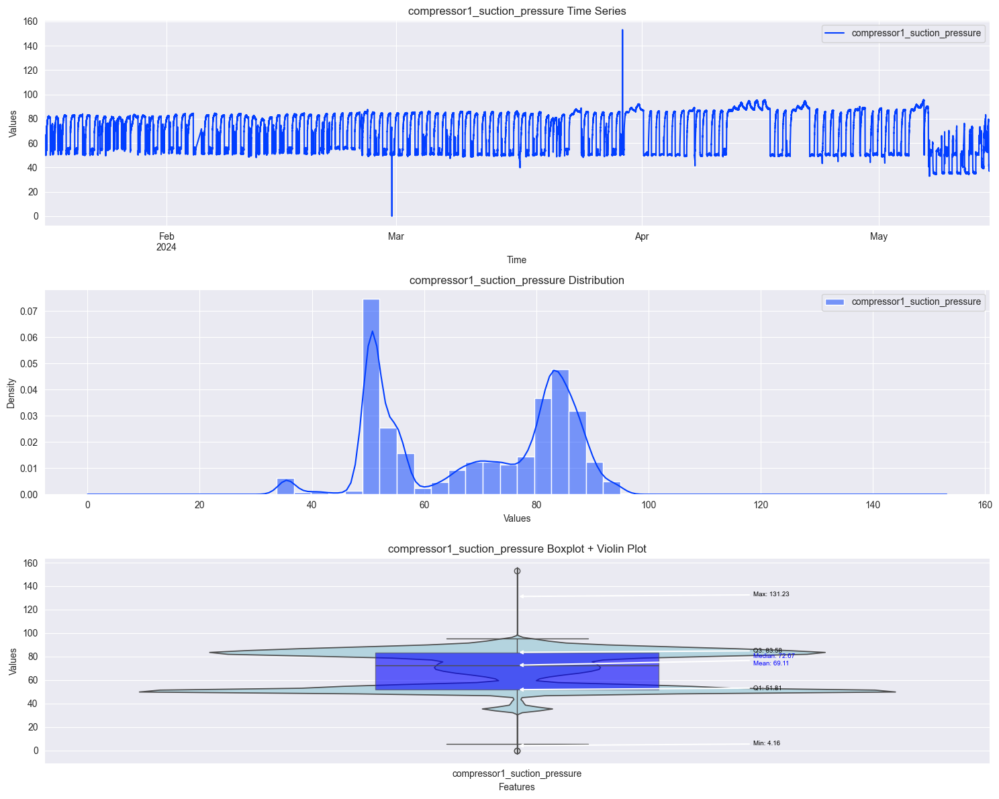

In [60]:
features = ['compressor1_suction_pressure']
title = 'compressor1_suction_pressure'
feature = 'compressor1_suction_pressure'

remove_outlier(df=df, threshold=200, feature=feature, condition='ffill')
remove_outlier(df=df, threshold=0, feature=feature, condition='bfill')
plot_statistical_graphs(df=df, features=features, title=title)

#### 2. compressor1_suction_temp x

                             count       mean         std  min   25%   50%  \
compressor1_suction_temp  172007.0  77.253105  217.674393 -2.0  12.0  32.2   

                           75%     max  
compressor1_suction_temp  39.0  1019.6  


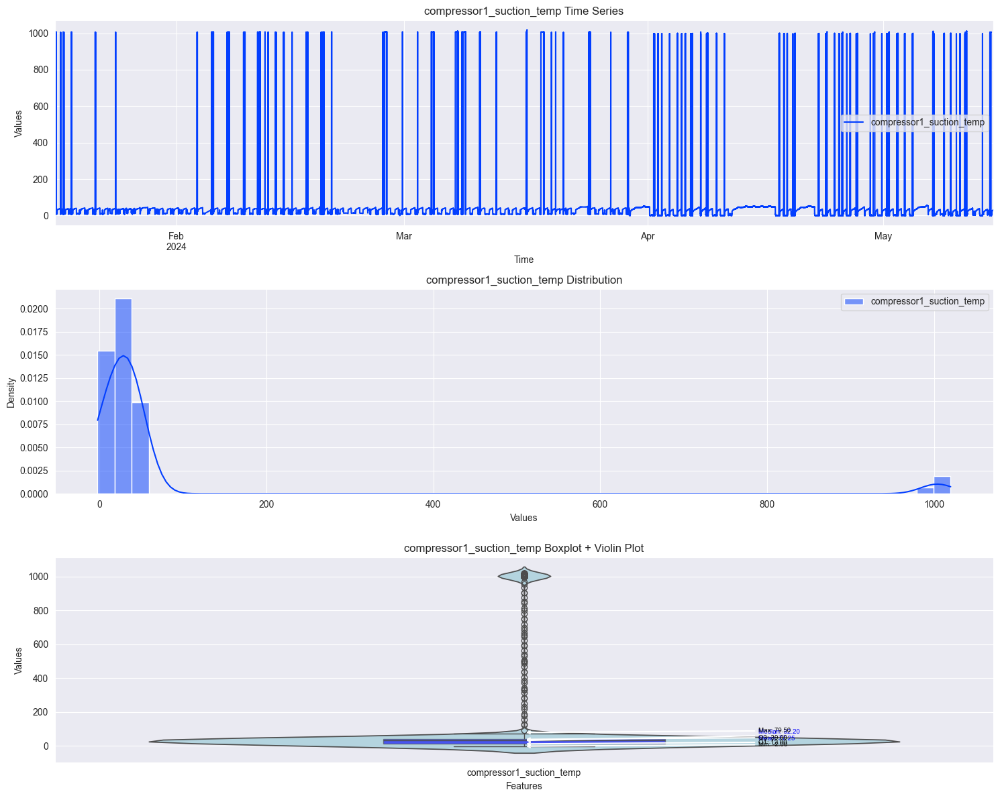

In [61]:
features = ['compressor1_suction_temp']
title = 'compressor1_suction_temp'
plot_statistical_graphs(df=df, features=features, title=title)

Forward fill applied
                             count       mean        std  min  25%   50%  \
compressor1_suction_temp  172007.0  25.006193  15.643722 -2.0  8.7  30.5   

                           75%   max  
compressor1_suction_temp  37.7  50.0  


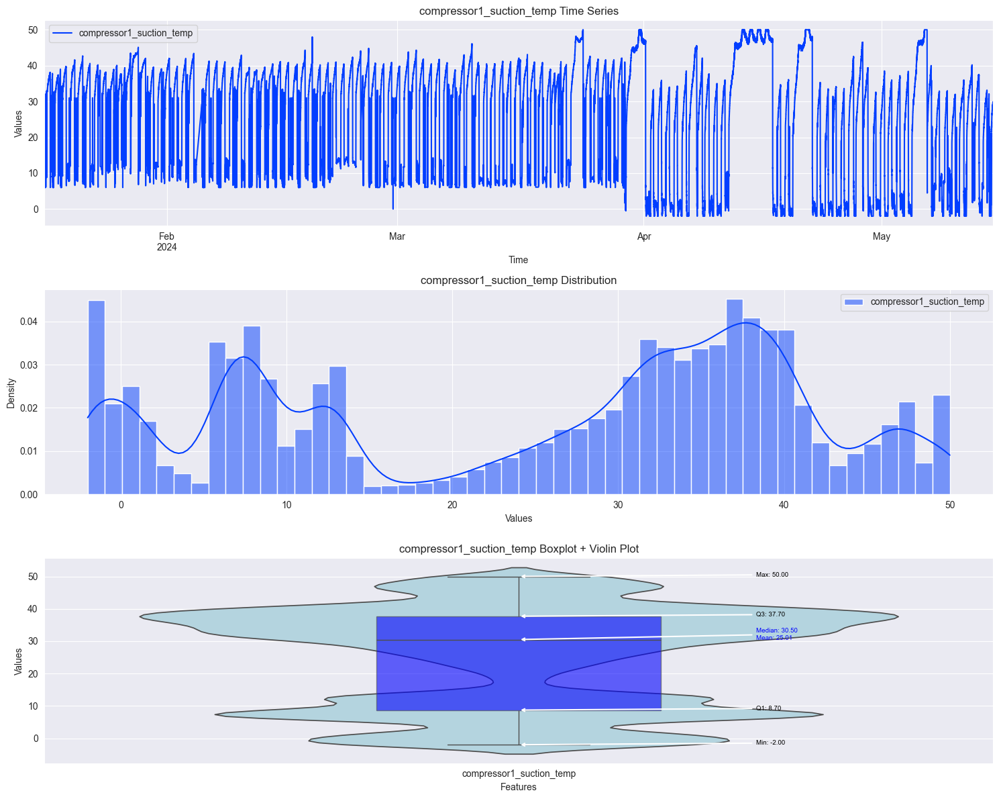

In [62]:
features = ['compressor1_suction_temp']
title = 'compressor1_suction_temp'
feature = 'compressor1_suction_temp'

remove_outlier(df=df, threshold=50, feature=feature, condition='ffill')
plot_statistical_graphs(df=df, features=features, title=title)

#### 1. condensor1_eqv_current_outdoor

                                   count      mean       std  min  25%  50%  \
condensor1_eqv_current_outdoor  172007.0  7.732514  9.491446  0.0  0.0  0.0   

                                  75%    max  
condensor1_eqv_current_outdoor  20.19  24.66  


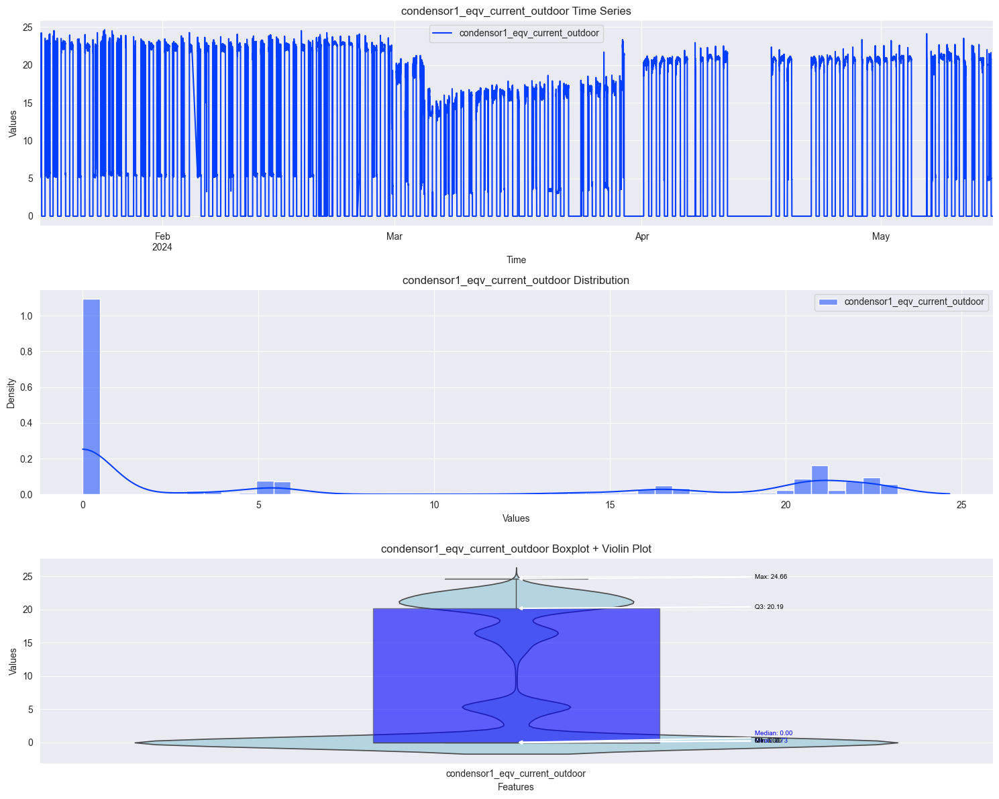

In [63]:
features = ['condensor1_eqv_current_outdoor']
title = 'condensor1_eqv_current_outdoor'
plot_statistical_graphs(df=df, features=features, title=title)

#### 2. condensor1_liquid x

                      count       mean      std  min   25%   50%   75%   max
condensor1_liquid  172007.0  27.842077  6.74343 -6.1  22.3  24.6  34.8  74.8


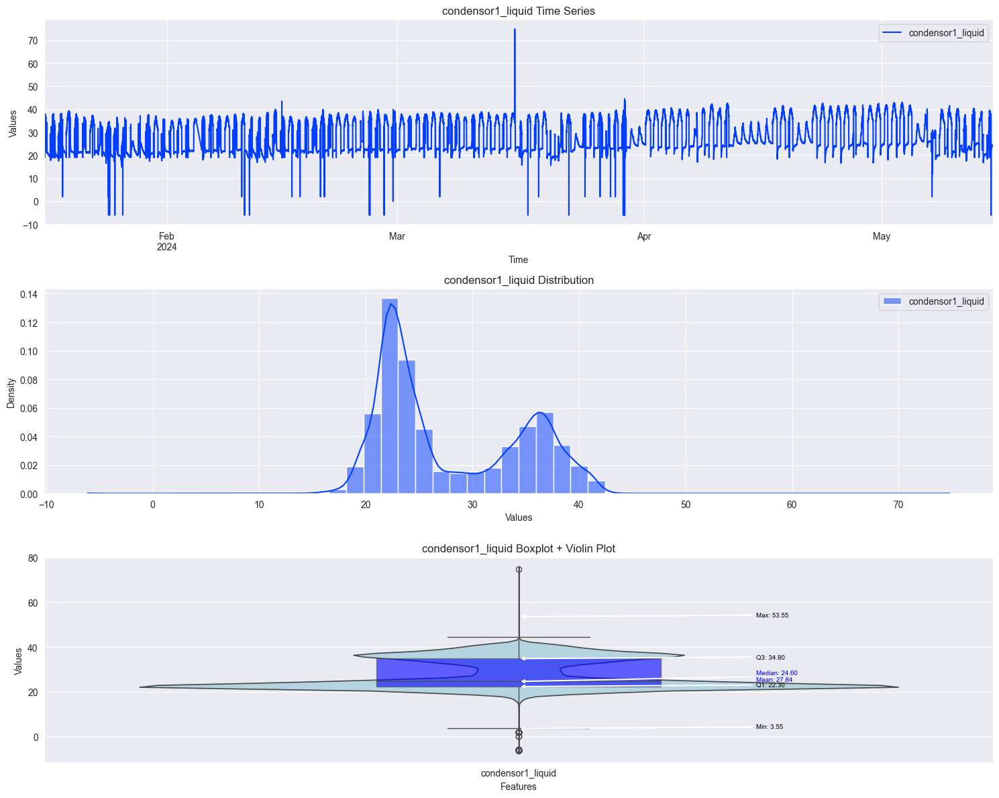

In [64]:
features = ['condensor1_liquid']
title = 'condensor1_liquid'
plot_statistical_graphs(df=df, features=features, title=title)

Forward fill applied
Backward fill applied
                      count       mean       std        min   25%   50%   75%  \
condensor1_liquid  172007.0  27.856772  6.718857  11.166667  22.3  24.6  34.8   

                    max  
condensor1_liquid  44.5  


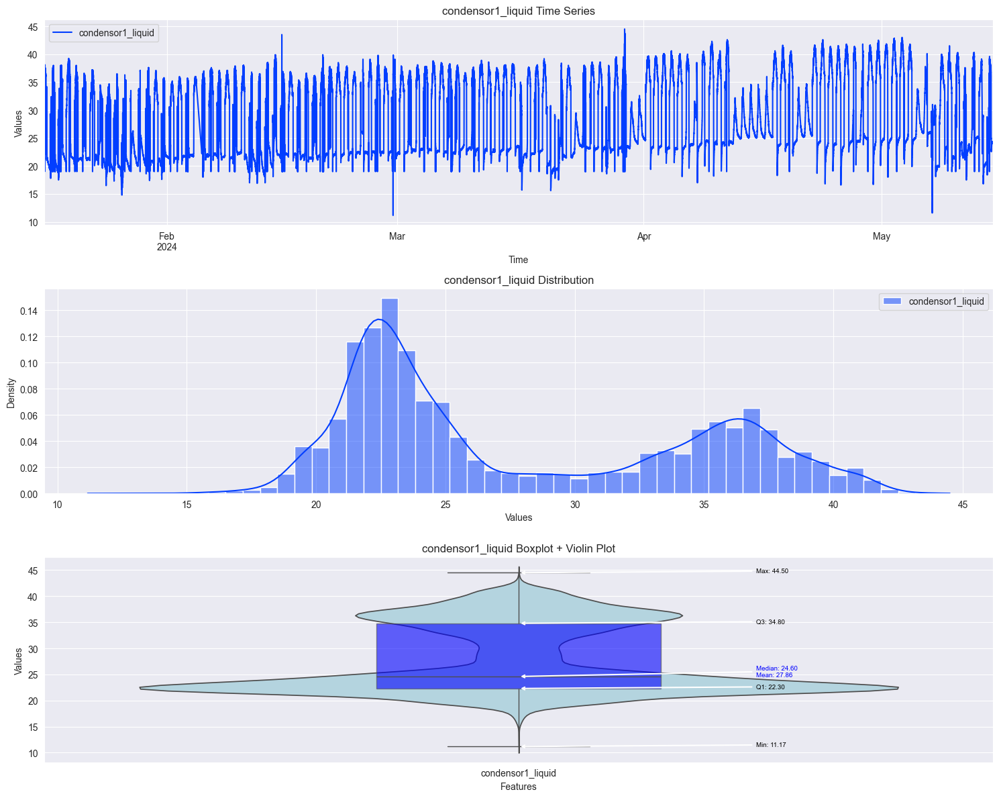

In [65]:
features = ['condensor1_liquid']
title = 'condensor1_liquid'
feature = 'condensor1_liquid'

remove_outlier(df=df, threshold=60, feature=feature, condition='ffill')
remove_outlier(df=df, threshold=10, feature=feature, condition='bfill')
plot_statistical_graphs(df=df, features=features, title=title)

#### 3. condensor1_eqv_volt_outdoor

                                count        mean       std  min     25%  \
condensor1_eqv_volt_outdoor  172007.0  391.665069  6.921594  0.0  385.74   

                                50%     75%     max  
condensor1_eqv_volt_outdoor  393.86  397.17  405.41  


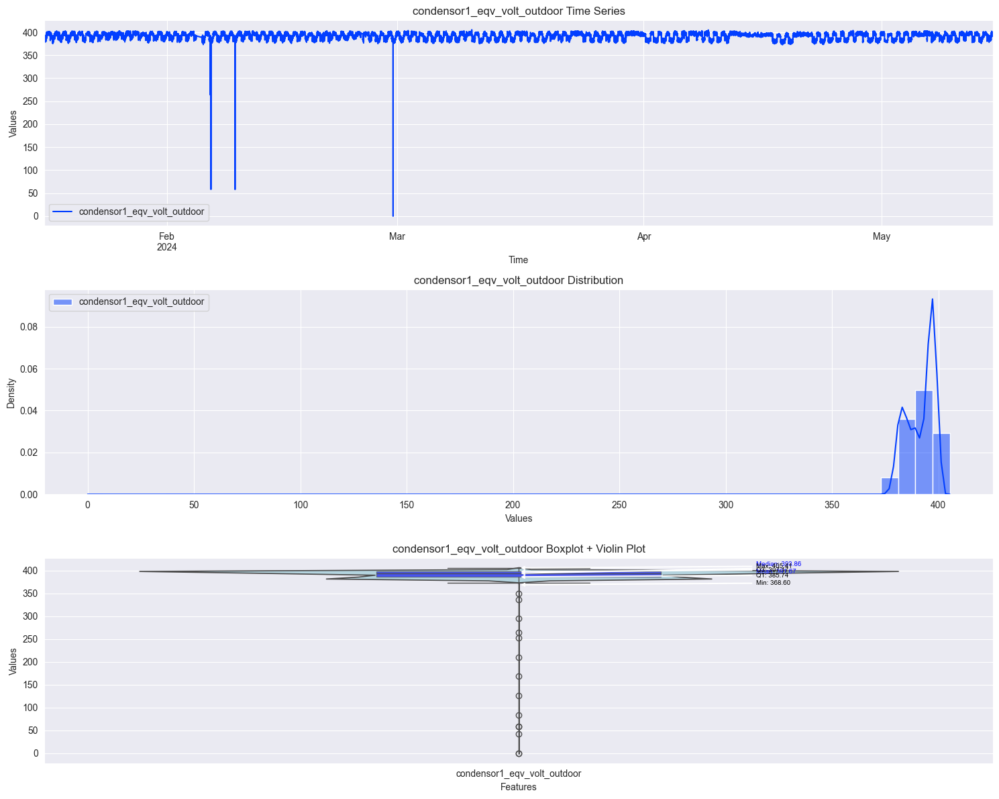

In [66]:
features = ['condensor1_eqv_volt_outdoor']
title = 'condensor1_eqv_volt_outdoor'
plot_statistical_graphs(df=df, features=features, title=title)

Backward fill applied
                                count        mean       std     min     25%  \
condensor1_eqv_volt_outdoor  172007.0  391.682851  6.511853  372.72  385.74   

                                50%     75%     max  
condensor1_eqv_volt_outdoor  393.86  397.17  405.41  


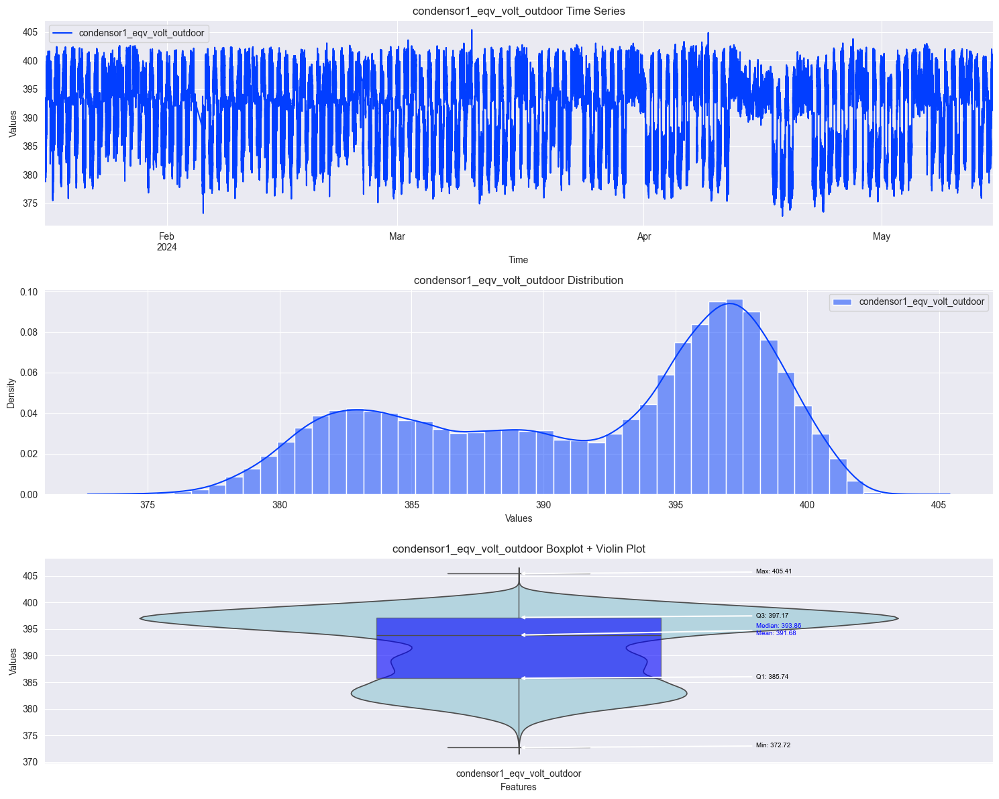

In [67]:
remove_outlier(df=df, threshold=350, feature='condensor1_eqv_volt_outdoor', condition='bfill')
plot_statistical_graphs(df=df, features=features, title=title)

#### 4. condensor1_discharge_pressure x

Low compressor or liquid pressure. is mersured at outline of Condensor
So, they must have pressure lower than 'high-pressure' 
and from the R22 spec sheet it have 
```python
'Critical Tempersture' = 96.15 celcius
'Critical Pressure' = 725.189 psi
```
and never higher than High-compressor

                                  count        mean        std  min     25%  \
condensor1_discharge_pressure  172007.0  232.715137  41.745002  0.0  204.06   

                                  50%     75%     max  
condensor1_discharge_pressure  214.73  281.02  369.78  


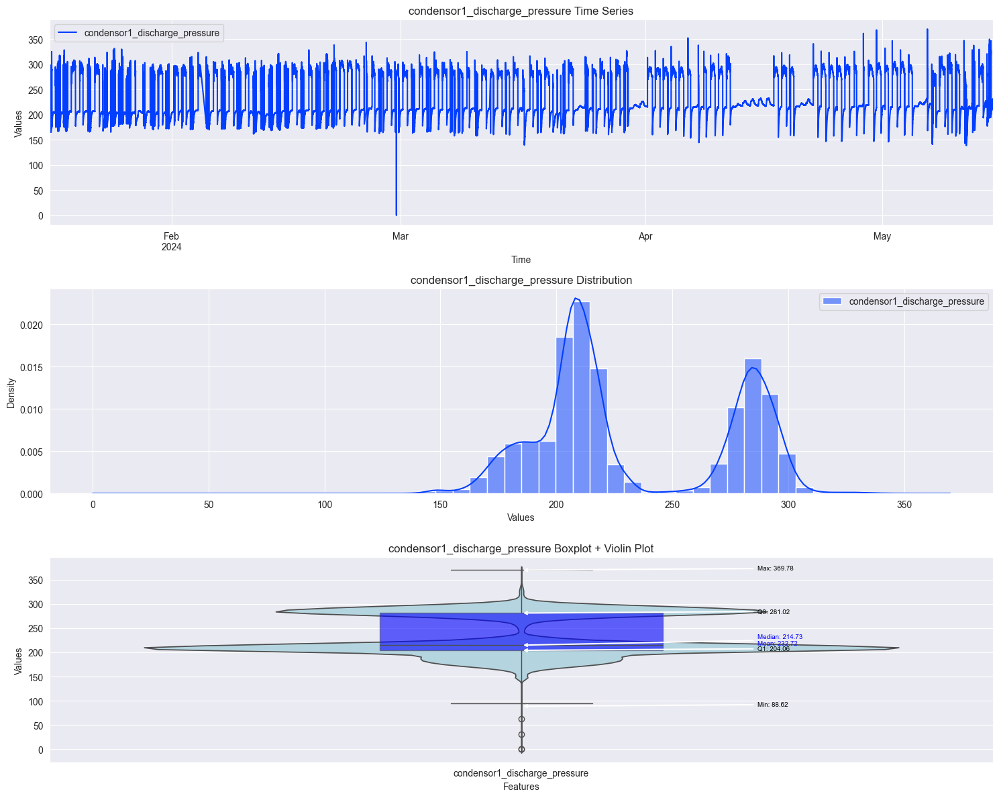

In [68]:
features = ['condensor1_discharge_pressure']
title = 'condensor1_discharge_pressure'
plot_statistical_graphs(df=df, features=features, title=title)

Forward fill applied
Backward fill applied
                                  count        mean        std         min  \
condensor1_discharge_pressure  172007.0  232.722309  41.732206  125.288889   

                                  25%     50%     75%     max  
condensor1_discharge_pressure  204.06  214.73  281.02  369.78  


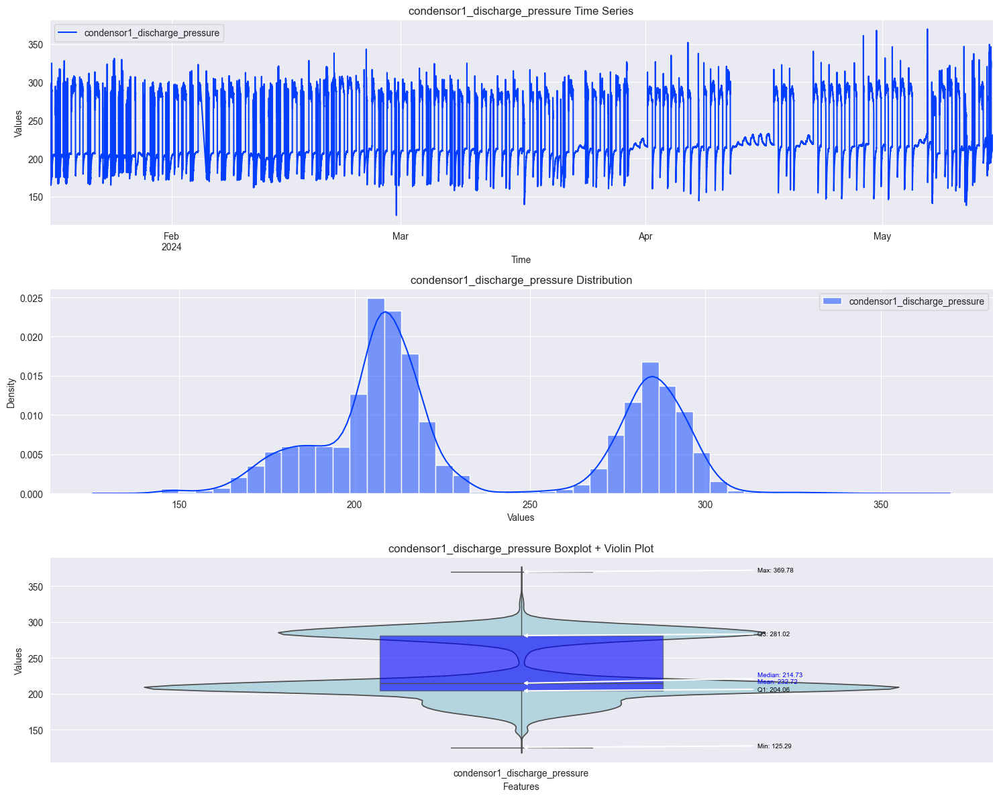

In [69]:
features = ['condensor1_discharge_pressure']
title = 'condensor1_discharge_pressure'
feature = 'condensor1_discharge_pressure'

remove_outlier(df=df, threshold=800, feature=feature, condition='ffill')
remove_outlier(df=df, threshold=100, feature=feature, condition='bfill')
plot_statistical_graphs(df=df, features=features, title=title)

#### 5. condensor1_discharge_temp x

                              count       mean        std  min   25%   50%  \
condensor1_discharge_temp  172007.0  37.177013  11.553216 -2.4  26.9  31.8   

                            75%   max  
condensor1_discharge_temp  49.8  74.3  


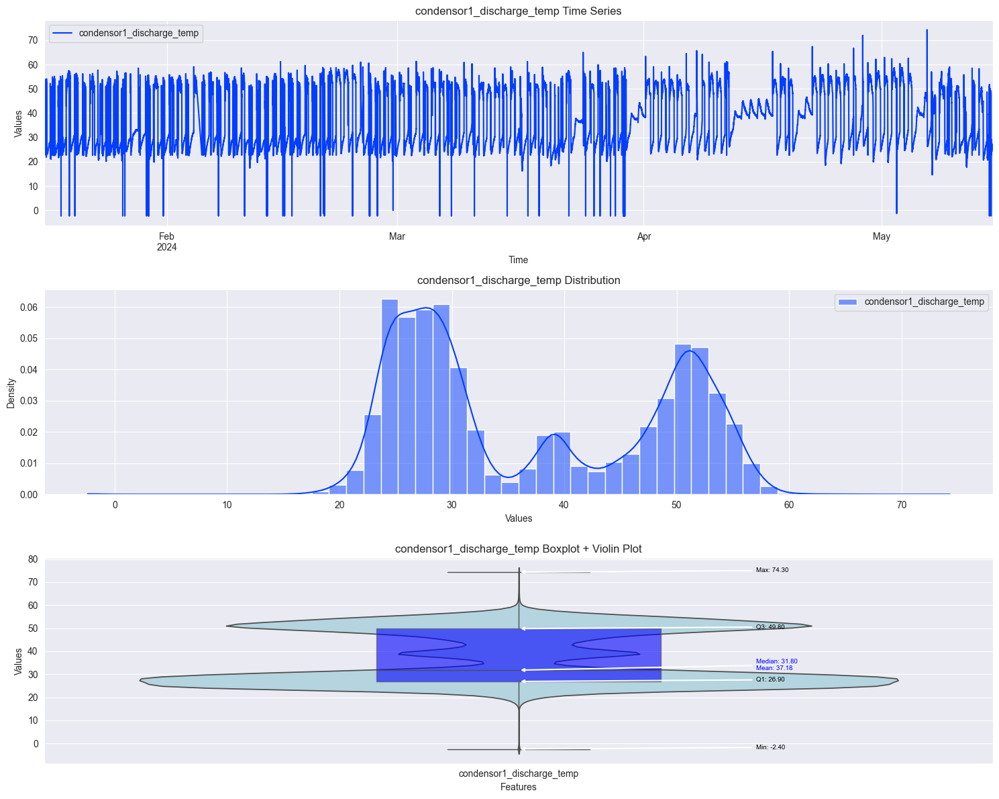

In [70]:
features = ['condensor1_discharge_temp']
title = 'condensor1_discharge_temp'
plot_statistical_graphs(df=df, features=features, title=title)

Forward fill applied
Backward fill applied
                              count       mean        std        min   25%  \
condensor1_discharge_temp  172007.0  37.194719  11.532377  11.044444  26.9   

                            50%   75%   max  
condensor1_discharge_temp  31.8  49.8  74.3  


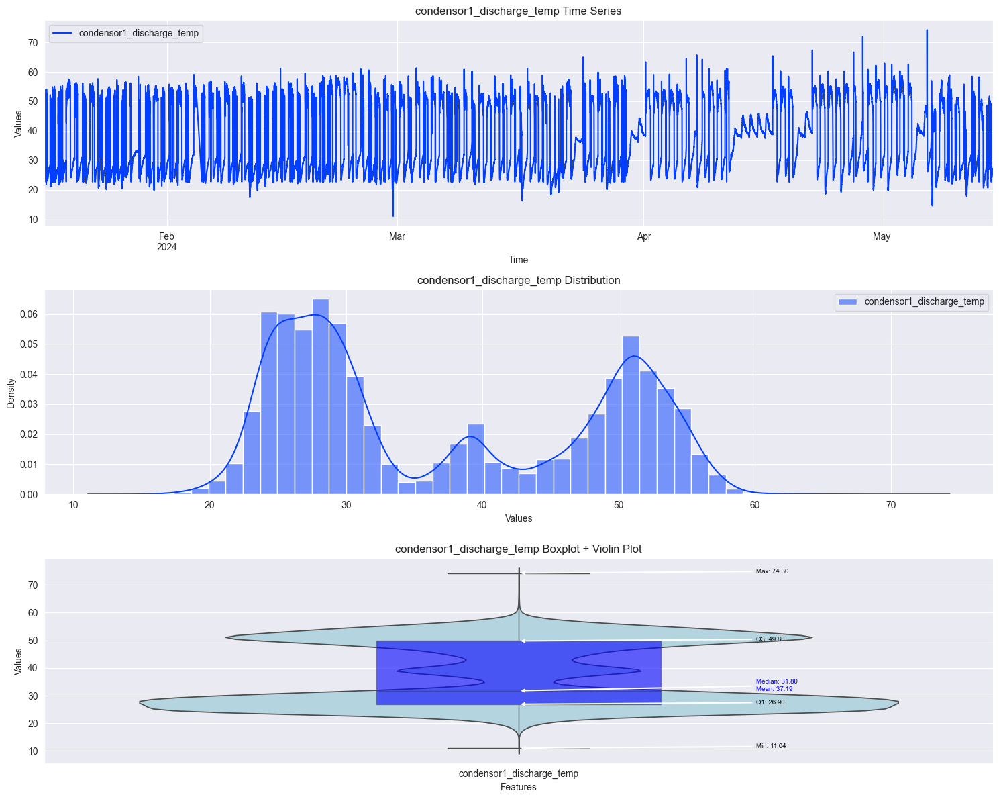

In [71]:
features = ['condensor1_discharge_temp']
title = 'condensor1_discharge_temp'
feature = 'condensor1_discharge_temp'

remove_outlier(df=df, threshold=150, feature=feature, condition='ffill')
remove_outlier(df=df, threshold=10, feature=feature, condition='bfill')
plot_statistical_graphs(df=df, features=features, title=title)

## AutoCorrelation Analysis ACF and PACF

Autocorrelation Function (ACF) and Partial Autocorrelation Function (PACF) are crucial tools in time series analysis, particularly in the identification of models like ARIMA. They provide insights into the correlation structure of a time series, helping determine the order of autoregressive and moving average components.

**Autocorrelation Function (ACF)**:
- The Autocorrelation Function describes the correlation between observations of a time series at two points in time, separated by a specific lag k. Essentially, it quantifies how a value in the time series is related to its previous values.

Insights from ACF:
- A slow decay in the ACF may suggest an autoregressive (AR) component.
A sharp cut-off in the ACF might indicate a moving average (MA) process.

**Partial Autocorrelation Function (PACF)**:
- While the ACF measures the correlation between two points with a given lag, it doesn’t account for the influence of other intervening observations. The PACF remedies this by measuring the correlation between two points, controlling for the values at all shorter lags.
- The PACF at lag k is the correlation between the series values k periods apart after accounting for the correlations at shorter lags 1,2,…,k−1.

Insights from PACF:
- A sharp cut-off in the PACF after a lag p might suggest an AR(p) component.
- A slow decay in the PACF may indicate an MA component.


In [79]:
def plot_acf_pacf(df, exclude_column='time-diff-minutes', lags=40):
    """
    Plots the ACF and PACF for each feature in the DataFrame, excluding the specified column,
    in a 2x17 grid layout (2 columns and 17 rows).

    Args:
        df (pd.DataFrame): DataFrame containing the time series data.
        exclude_column (str): The column name to exclude from the plotting. Default is 'time-diff-minutes'.
        lags (int): The number of lags to include in the ACF and PACF plots. Default is 40.

    Returns:
        None
    """
    # Get all column names except the excluded one
    # This filters out the column we don't want to plot (e.g., 'time-diff-minutes')
    columns = [col for col in df.columns if col != exclude_column]

    # Set up the matplotlib figure with 2 columns and 17 rows
    # The figsize=(20, 85) makes sure the plots are large enough to be readable
    fig, axes = plt.subplots(17, 2, figsize=(20, 85))  # 17 rows, 2 columns

    # Flatten axes for easy iteration
    # This turns our grid of axes into a flat array so we can loop through it easily
    axes = axes.flatten()

    # Iterate over each feature (column) in our DataFrame
    for i, feature in enumerate(columns):
        # Check if we are within the limits of our grid of subplots
        if i * 2 < len(axes):
            # Plot ACF on the left column
            # We drop any NaN values from the feature column before plotting
            plot_acf(df[feature].dropna(), lags=lags, ax=axes[i * 2])
            axes[i * 2].set_title(f'ACF of {feature}')
            axes[i * 2].set_xlabel('Lags')
            axes[i * 2].set_ylabel('ACF')

            # Plot PACF on the right column
            # 'ywm' is a method used for better PACF estimation
            plot_pacf(df[feature].dropna(), lags=lags, ax=axes[i * 2 + 1], method='ywm')
            axes[i * 2 + 1].set_title(f'PACF of {feature}')
            axes[i * 2 + 1].set_xlabel('Lags')
            axes[i * 2 + 1].set_ylabel('PACF')

    # Hide any extra subplots if we have fewer features than available plots
    # This prevents showing empty plots if we don't have enough features
    for j in range((i + 1) * 2, len(axes)):
        fig.delaxes(axes[j])

    # Adjust the layout to prevent subplots from overlapping
    plt.tight_layout()

    # Display the plots
    plt.show()

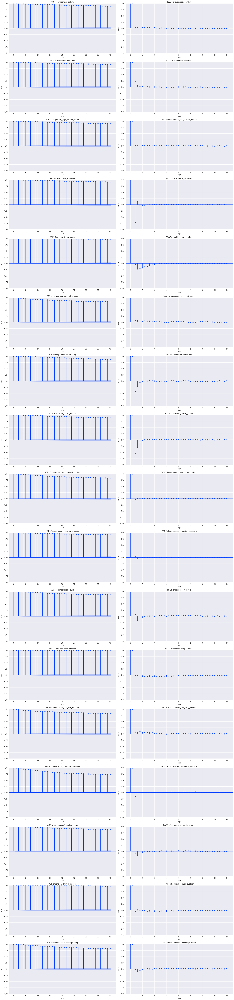

In [80]:
plot_acf_pacf(df=df, lags=40)

## Stationarity

https://www.machinelearningplus.com/time-series/augmented-dickey-fuller-test/

**Unit Root Test**
- Unit root is a characteristic of a time series that makes it non-stationary. Technically speaking, a unit root is said to exist in a time series of the value of alpha = 1 in the below equation.
- The presence of a unit root means the time series is non-stationary. Besides, the number of unit roots contained in the series corresponds to the number of differencing operations required to make the series stationary.

**Dickey-Fuller Test**
- A Dickey-Fuller test is a unit root test that tests the null hypothesis that α=1 alpha is the coefficient of the first lag on Y. Null Hypothesis (H0): alpha=1
- Fundamentally, it has a similar null hypothesis as the unit root test. That is, the coefficient of Y(t-1) is 1, implying the presence of a unit root. If not rejected, the series is taken to be non-stationary.
- The Augmented Dickey-Fuller test evolved based on the above equation and is one of the most common form of Unit Root test.

**Augmented Dickey Fuller (ADF)**
- The ADF test expands the Dickey-Fuller test equation to include high order regressive process in the model.
- If you notice, we have only added more differencing terms, while the rest of the equation remains the same. This adds more thoroughness to the test. The null hypothesis however is still the same as the Dickey Fuller test.
- A key point to remember here is: Since the null hypothesis assumes the presence of unit root, that is α=1, the p-value obtained should be less than the significance level (say 0.05) in order to reject the null hypothesis. Thereby, inferring that the series is stationary.
- However, this is a very common mistake analysts commit with this test. That is, if the p-value is less than significance level, people mistakenly take the series to be non-stationary.

In [85]:
from statsmodels.tsa.stattools import adfuller

def check_stationarity(df, exclude_column='time-diff-minutes', window=12, alpha=0.05):
    """
    Checks the stationarity of all time series features in a DataFrame, excluding the specified column,
    and plots rolling statistics for each feature.

    Args:
        df (pd.DataFrame): DataFrame containing the time series data.
        exclude_column (str): The column name to exclude from the stationarity check. Default is 'time-diff-minutes'.
        window (int): The window size for calculating rolling statistics.
        alpha (float): Significance level for the ADF test. Default is 0.05.

    Returns:
        None
    """
    
    # Get all column names except the excluded one
    columns = [col for col in df.columns if col != exclude_column]
    
    for feature in columns:
        print(f"\nChecking stationarity for: {feature}")

        # Plot rolling statistics (mean and standard deviation)
        rolling_mean = df[feature].rolling(window=window).mean()
        rolling_std = df[feature].rolling(window=window).std()

        plt.figure(figsize=(12, 6))
        plt.plot(df[feature], color='blue', label=f'Original {feature}')
        plt.plot(rolling_mean, color='red', label='Rolling Mean')
        plt.plot(rolling_std, color='black', label='Rolling Std')
        plt.title(f'Rolling Mean & Standard Deviation for {feature}')
        plt.xlabel('Time')
        plt.ylabel('Value')
        plt.legend(loc='best')
        plt.show()

        # 3. Perform Augmented Dickey-Fuller test
        print("Performing Augmented Dickey-Fuller Test:")
        result = adfuller(df[feature].dropna())
        
        print(f"ADF Statistic: {result[0]}")
        print(f"p-value: {result[1]}")
        print(f"Critical Values:")
        for key, value in result[4].items():
            print(f"   {key}: {value}")

        # Interpret ADF test results
        if result[1] < alpha:
            print(f"p-value = {result[1]} < {alpha}: The series is stationary.")
        else:
            print(f"p-value = {result[1]} >= {alpha}: The series is non-stationary.")


Checking stationarity for: evaporator_airflow


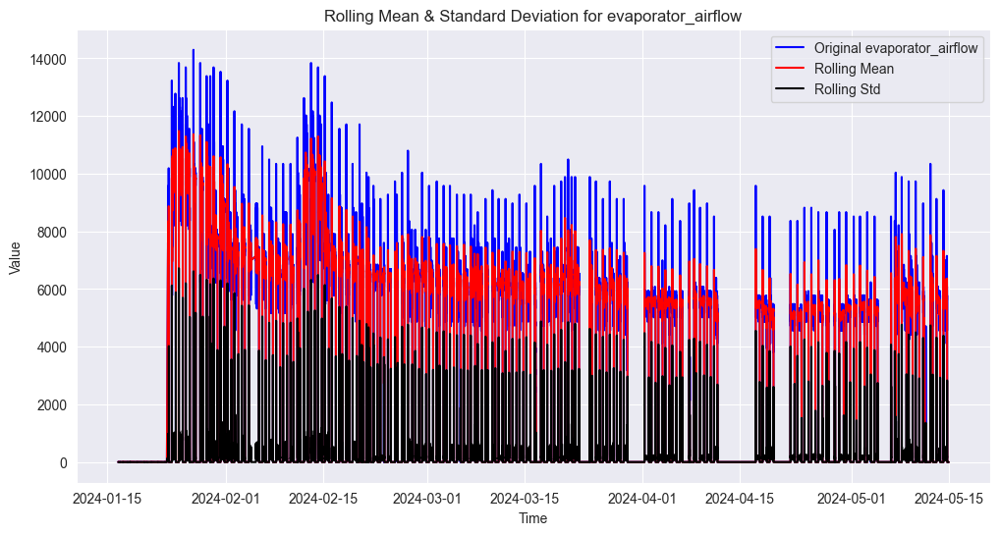

Performing Augmented Dickey-Fuller Test:
ADF Statistic: -14.73963851102347
p-value: 2.5828295581319475e-27
Critical Values:
   1%: -3.430388027934013
   5%: -2.8615568078285616
   10%: -2.5667789462054915
p-value = 2.5828295581319475e-27 < 0.05: The series is stationary.

Checking stationarity for: evaporator_motorfcu


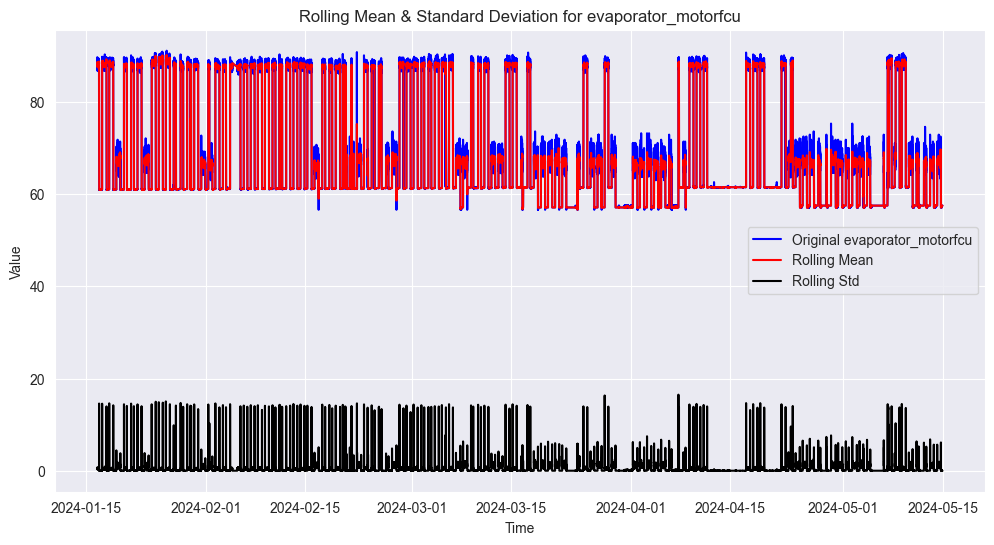

Performing Augmented Dickey-Fuller Test:
ADF Statistic: -13.681664551602646
p-value: 1.3968364847641328e-25
Critical Values:
   1%: -3.430388020858737
   5%: -2.861556804701406
   10%: -2.566778944541015
p-value = 1.3968364847641328e-25 < 0.05: The series is stationary.

Checking stationarity for: evaporator_eqv_current_indoor


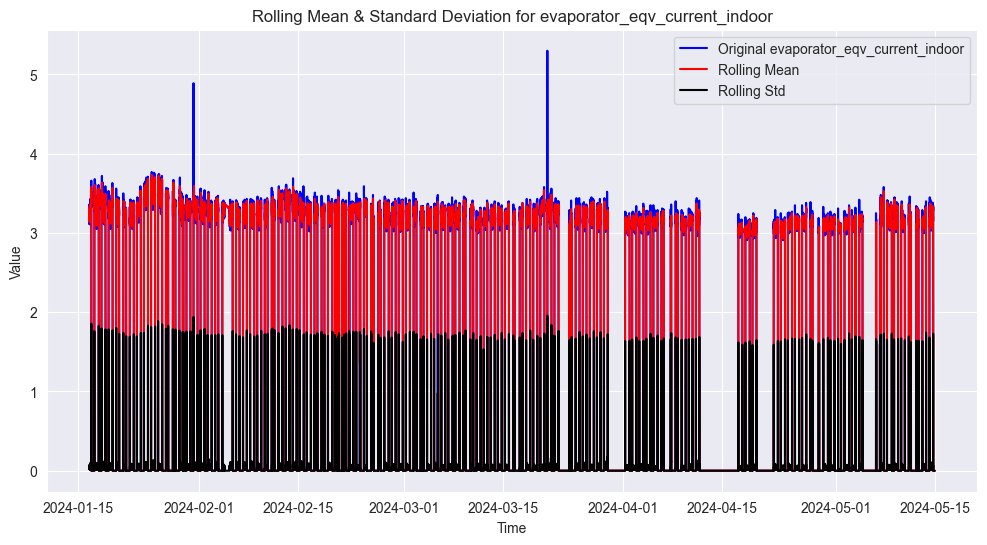

Performing Augmented Dickey-Fuller Test:
ADF Statistic: -15.429005768819327
p-value: 2.965574781556208e-28
Critical Values:
   1%: -3.430388030366747
   5%: -2.8615568089037904
   10%: -2.566778946777798
p-value = 2.965574781556208e-28 < 0.05: The series is stationary.

Checking stationarity for: evaporator_supplyair


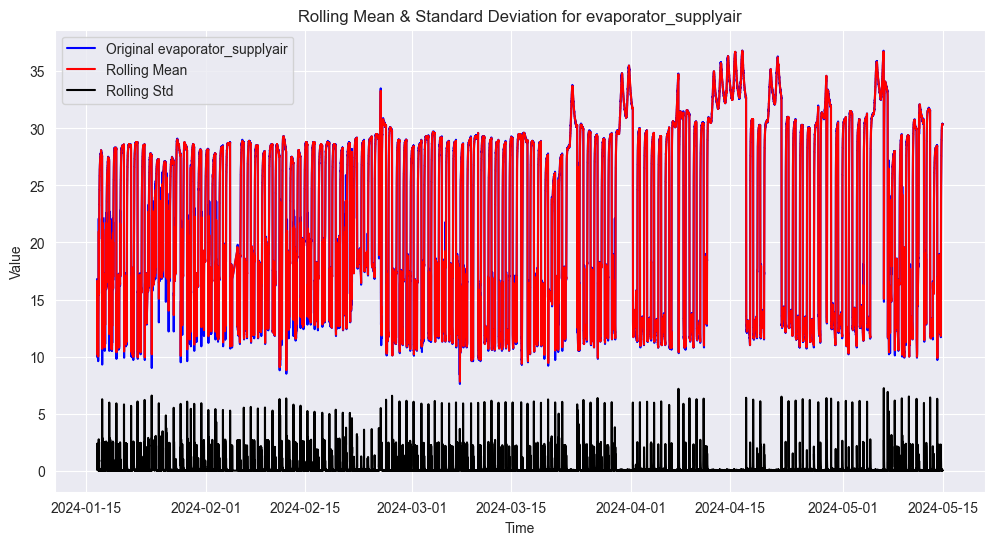

Performing Augmented Dickey-Fuller Test:
ADF Statistic: -13.777486216171258
p-value: 9.430728998353579e-26
Critical Values:
   1%: -3.4303880301455765
   5%: -2.8615568088060366
   10%: -2.5667789467257673
p-value = 9.430728998353579e-26 < 0.05: The series is stationary.

Checking stationarity for: ambient_temp_indoor


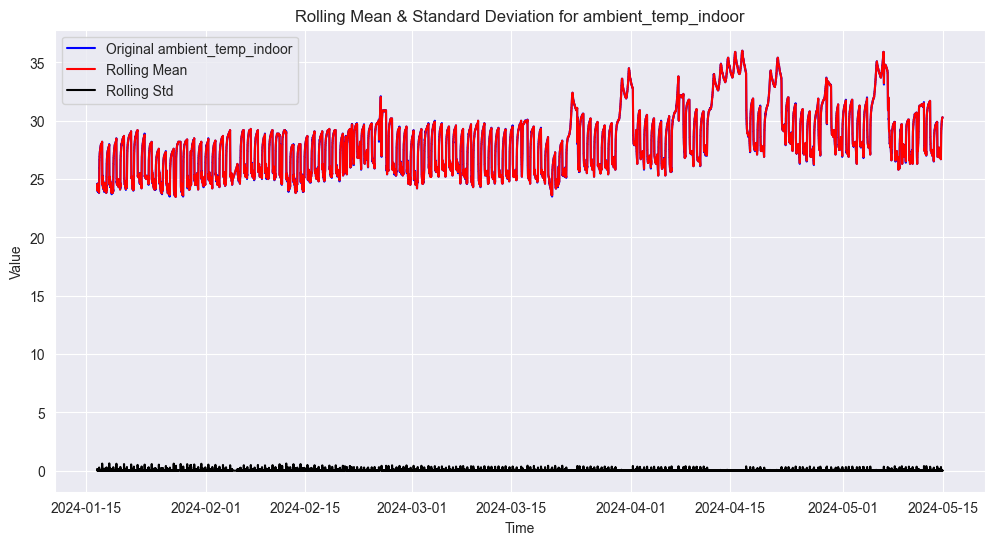

Performing Augmented Dickey-Fuller Test:
ADF Statistic: -9.18554661125769
p-value: 2.1926994939615175e-15
Critical Values:
   1%: -3.430388028155158
   5%: -2.8615568079263043
   10%: -2.566778946257516
p-value = 2.1926994939615175e-15 < 0.05: The series is stationary.

Checking stationarity for: evaporator_eqv_volt_indoor


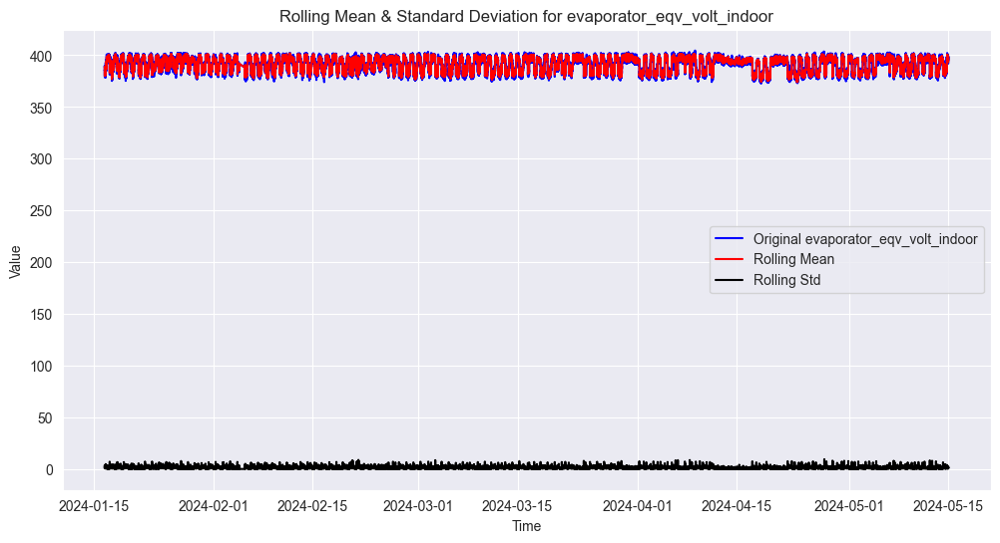

Performing Augmented Dickey-Fuller Test:
ADF Statistic: -14.878251156882762
p-value: 1.6241209481515345e-27
Critical Values:
   1%: -3.430388033020994
   5%: -2.8615568100769235
   10%: -2.5667789474022165
p-value = 1.6241209481515345e-27 < 0.05: The series is stationary.

Checking stationarity for: evaporator_return_temp


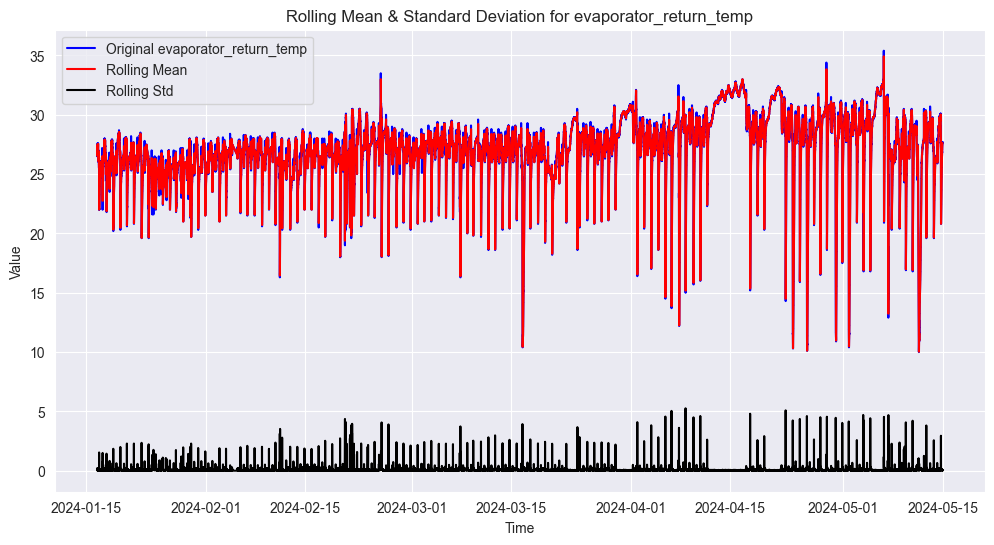

Performing Augmented Dickey-Fuller Test:
ADF Statistic: -17.6794950028427
p-value: 3.613687796650685e-30
Critical Values:
   1%: -3.430388034790698
   5%: -2.8615568108591036
   10%: -2.566778947818544
p-value = 3.613687796650685e-30 < 0.05: The series is stationary.

Checking stationarity for: ambient_humid_indoor


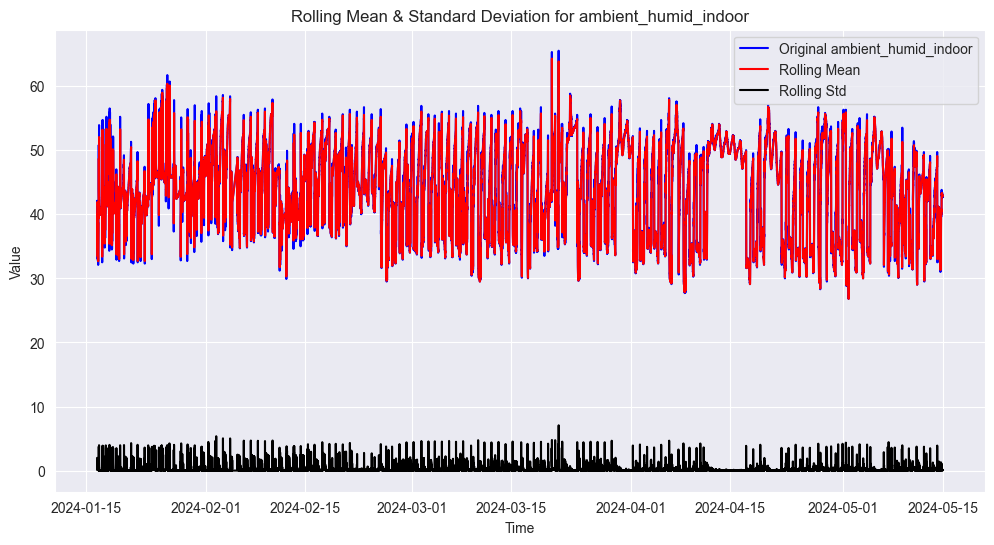

Performing Augmented Dickey-Fuller Test:
ADF Statistic: -14.378769566006467
p-value: 9.228430635243206e-27
Critical Values:
   1%: -3.4303880356756116
   5%: -2.861556811250221
   10%: -2.566778948026722
p-value = 9.228430635243206e-27 < 0.05: The series is stationary.

Checking stationarity for: condensor1_eqv_current_outdoor


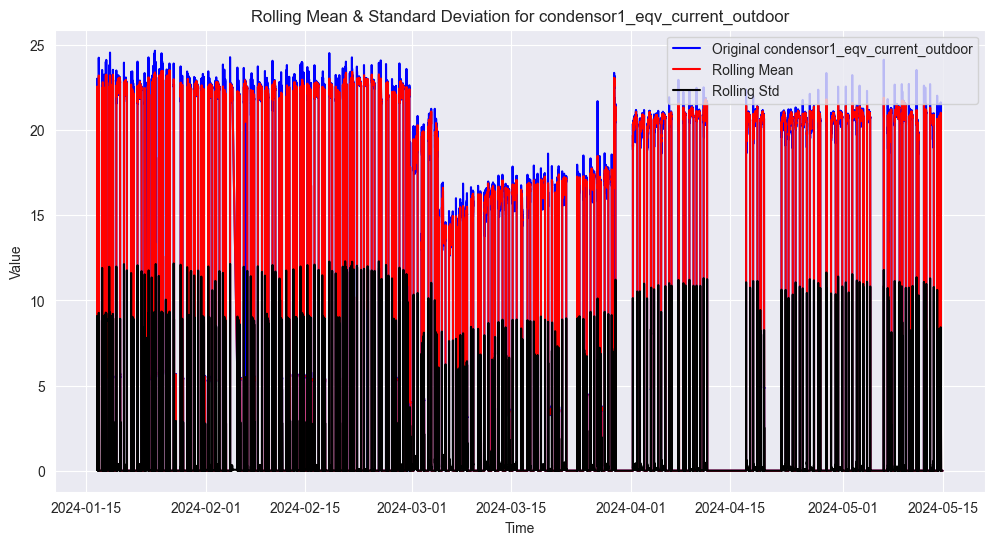

Performing Augmented Dickey-Fuller Test:
ADF Statistic: -15.428494791032614
p-value: 2.9699368291657987e-28
Critical Values:
   1%: -3.4303880350119225
   5%: -2.8615568109568814
   10%: -2.566778947870587
p-value = 2.9699368291657987e-28 < 0.05: The series is stationary.

Checking stationarity for: compressor1_suction_pressure


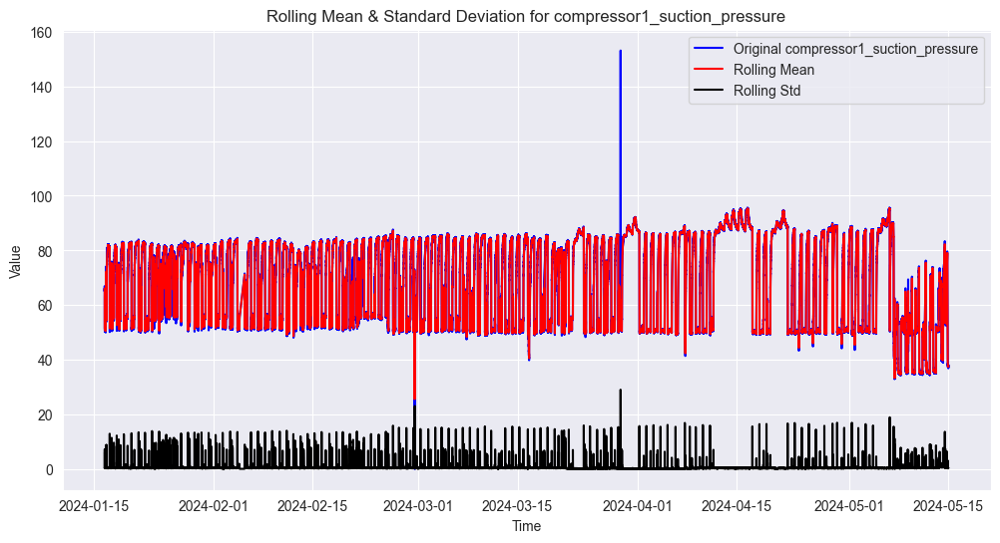

Performing Augmented Dickey-Fuller Test:
ADF Statistic: -12.809512093876677
p-value: 6.491814618412448e-24
Critical Values:
   1%: -3.430388027934013
   5%: -2.8615568078285616
   10%: -2.5667789462054915
p-value = 6.491814618412448e-24 < 0.05: The series is stationary.

Checking stationarity for: condensor1_liquid


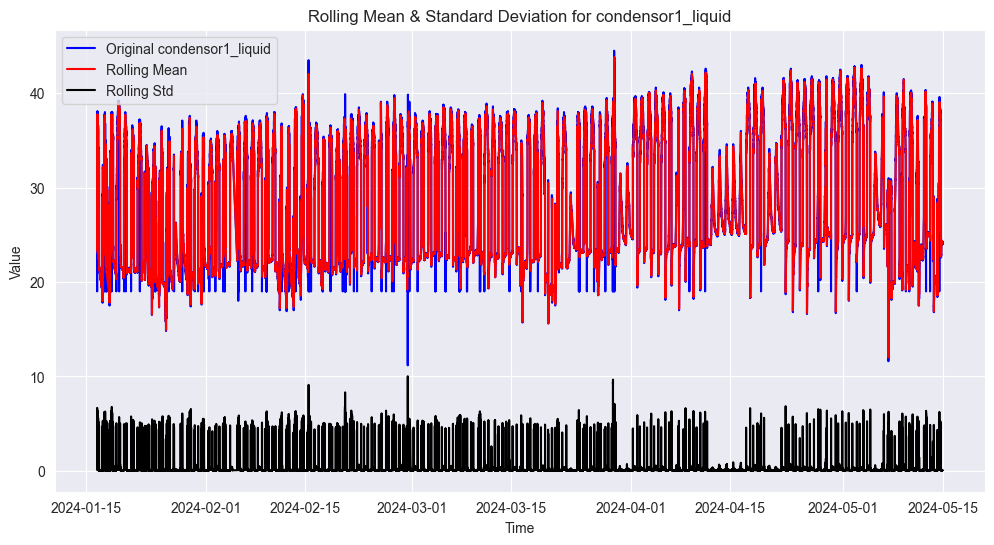

Performing Augmented Dickey-Fuller Test:
ADF Statistic: -13.632050632994192
p-value: 1.715916226114849e-25
Critical Values:
   1%: -3.4303880352331495
   5%: -2.86155681105466
   10%: -2.5667789479226317
p-value = 1.715916226114849e-25 < 0.05: The series is stationary.

Checking stationarity for: ambient_temp_outdoor


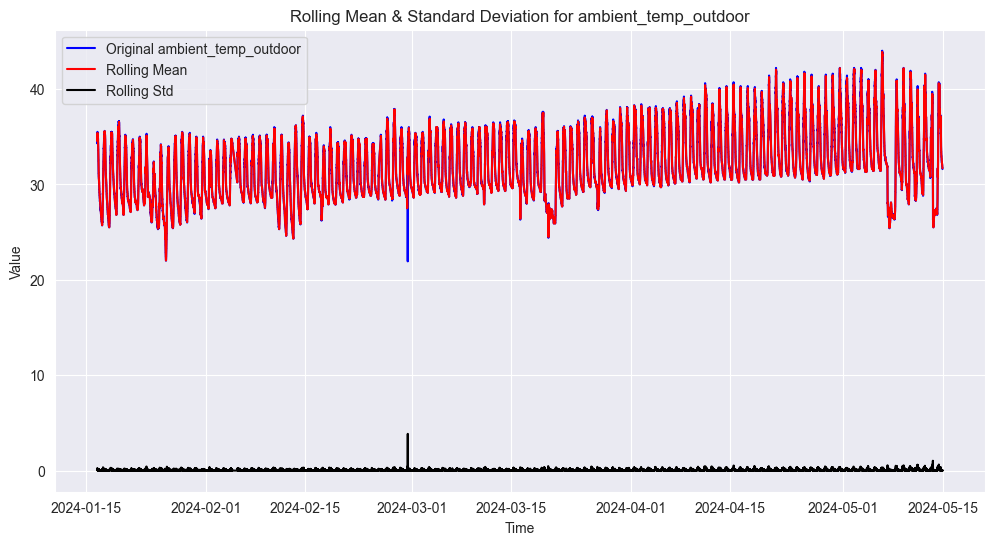

Performing Augmented Dickey-Fuller Test:
ADF Statistic: -17.13766598709095
p-value: 7.079728713499538e-30
Critical Values:
   1%: -3.4303880356756116
   5%: -2.861556811250221
   10%: -2.566778948026722
p-value = 7.079728713499538e-30 < 0.05: The series is stationary.

Checking stationarity for: condensor1_eqv_volt_outdoor


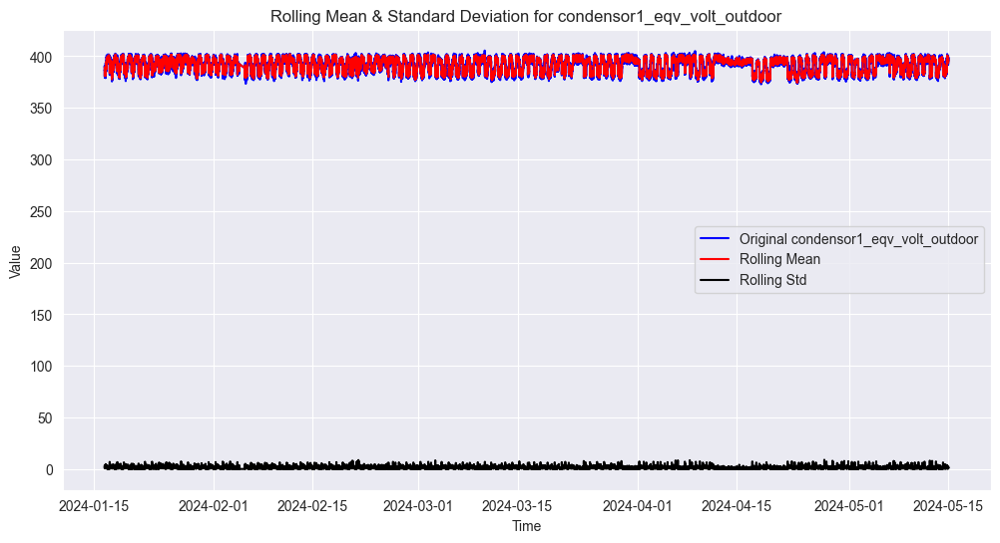

Performing Augmented Dickey-Fuller Test:
ADF Statistic: -14.931502146208352
p-value: 1.3641468796377055e-27
Critical Values:
   1%: -3.430388033020994
   5%: -2.8615568100769235
   10%: -2.5667789474022165
p-value = 1.3641468796377055e-27 < 0.05: The series is stationary.

Checking stationarity for: condensor1_discharge_pressure


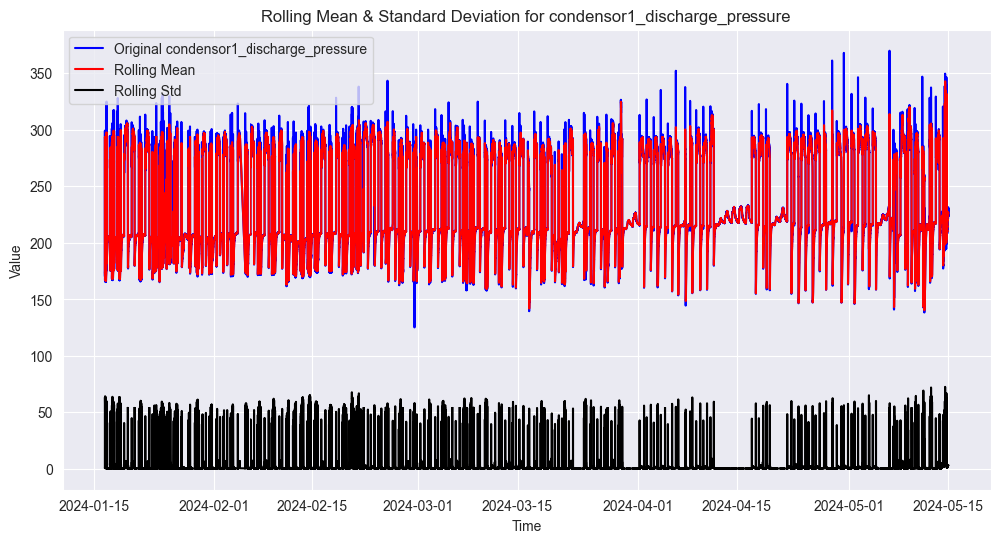

Performing Augmented Dickey-Fuller Test:
ADF Statistic: -16.75239084336698
p-value: 1.3306279292299723e-29
Critical Values:
   1%: -3.4303880352331495
   5%: -2.86155681105466
   10%: -2.5667789479226317
p-value = 1.3306279292299723e-29 < 0.05: The series is stationary.

Checking stationarity for: compressor1_suction_temp


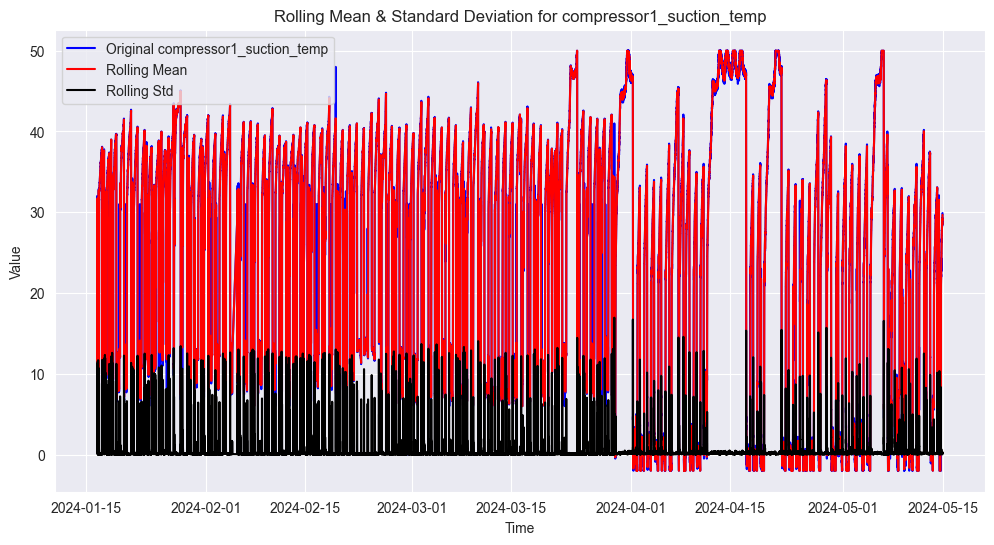

Performing Augmented Dickey-Fuller Test:
ADF Statistic: -13.10918678330479
p-value: 1.6483068574130339e-24
Critical Values:
   1%: -3.430388034569476
   5%: -2.861556810761327
   10%: -2.5667789477665006
p-value = 1.6483068574130339e-24 < 0.05: The series is stationary.

Checking stationarity for: ambient_humid_outdoor


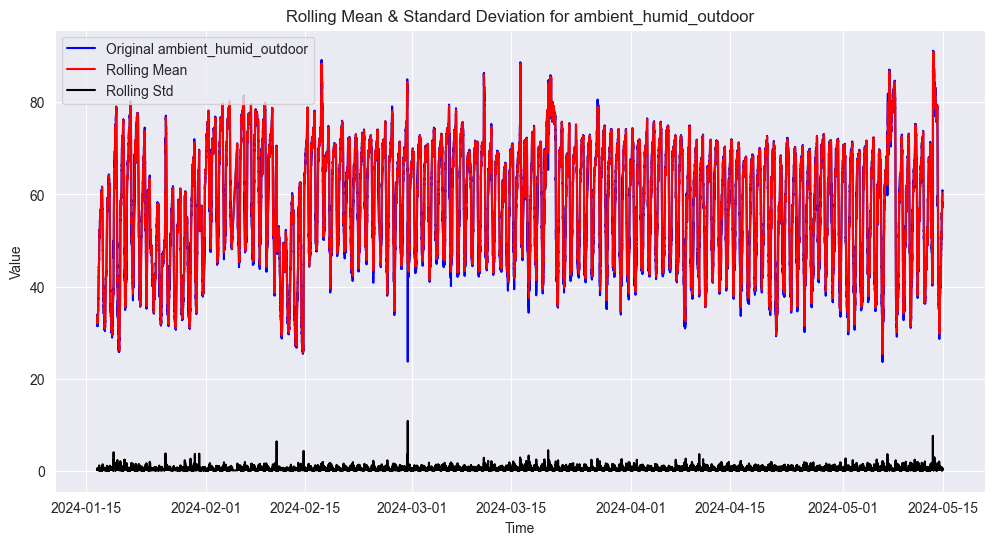

Performing Augmented Dickey-Fuller Test:
ADF Statistic: -15.903303140531285
p-value: 8.281571724239862e-29
Critical Values:
   1%: -3.4303880356756116
   5%: -2.861556811250221
   10%: -2.566778948026722
p-value = 8.281571724239862e-29 < 0.05: The series is stationary.

Checking stationarity for: condensor1_discharge_temp


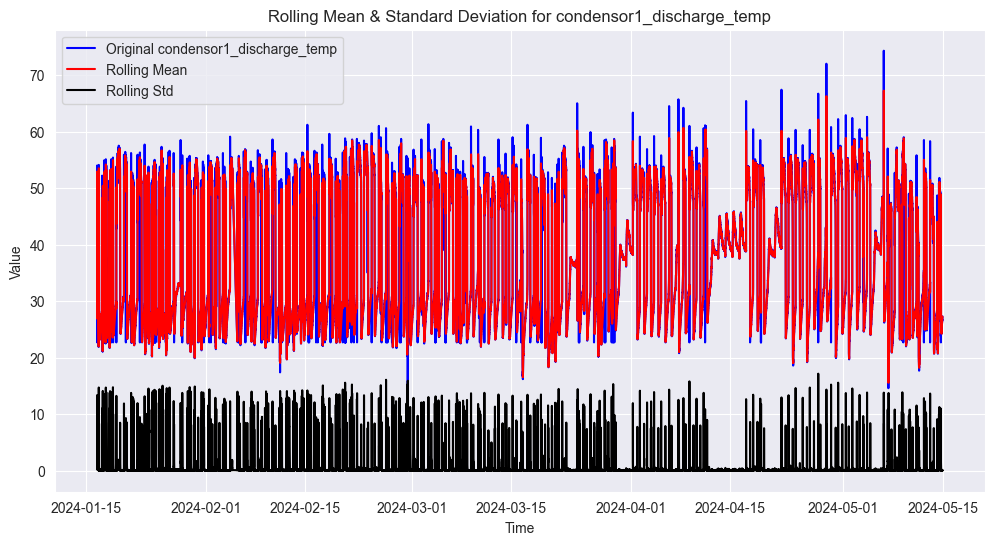

Performing Augmented Dickey-Fuller Test:
ADF Statistic: -15.22141588077074
p-value: 5.47855549404022e-28
Critical Values:
   1%: -3.4303880352331495
   5%: -2.86155681105466
   10%: -2.5667789479226317
p-value = 5.47855549404022e-28 < 0.05: The series is stationary.


In [86]:
check_stationarity(df, window=12, alpha=0.05)

## Seasonality and Cyclic Patterns

The quickest way to get an idea of whether or not your data has a seasonal trend is by plotting it. https://towardsdatascience.com/finding-seasonal-trends-in-time-series-data-with-python-ce10c37aa861

In [92]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 172007 entries, 2024-01-16 13:13:00+07:00 to 2024-05-14 23:59:00+07:00
Freq: T
Data columns (total 18 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   evaporator_airflow              172007 non-null  float64
 1   evaporator_motorfcu             172007 non-null  float64
 2   evaporator_eqv_current_indoor   172007 non-null  float64
 3   evaporator_supplyair            172007 non-null  float64
 4   ambient_temp_indoor             172007 non-null  float64
 5   evaporator_eqv_volt_indoor      172007 non-null  float64
 6   evaporator_return_temp          172007 non-null  float64
 7   ambient_humid_indoor            172007 non-null  float64
 8   condensor1_eqv_current_outdoor  172007 non-null  float64
 9   compressor1_suction_pressure    172007 non-null  float64
 10  condensor1_liquid               172007 non-null  float64
 11  ambient_temp_outdoor    

In [97]:
# from statsmodels.tsa.seasonal import seasonal_decompose

# def seasonal_plot(df, exclude_column='time-diff-minutes', model='multiplicative'):
#     columns = [col for col in df.columns if col != exclude_column]

#     for feature in columns:
#         if df[feature].min() <= 0:
#             print(f"Skipping feature {feature} due to non-positive values.")
#             continue
        
#         print(f"\nDecomposing feature: {feature}")
#         analysis = df[[feature]].copy()
#         decompose_result = seasonal_decompose(analysis, model=model)
        
#         plt.figure(figsize=(10, 8))
#         decompose_result.plot()
#         plt.suptitle(f'Seasonal Decomposition of {feature} ({model} model)')
#         plt.show()

In [98]:
# seasonal_plot(df=df)

Skipping feature evaporator_airflow due to non-positive values.

Decomposing feature: evaporator_motorfcu


ValueError: freq T not understood. Please report if you think this is in error.

# ⚙️ 2. Feature Engineering

In [72]:
df_eda = df.copy()
df_eda.describe().T

,count,mean,std,min,25%,50%,75%,max
evaporator_airflow,172007.0,2778.101042,3321.166074,0.000000,0.00,0.00,6084.00,14297.40
evaporator_motorfcu,172007.0,68.639136,11.822179,56.600000,61.10,61.50,87.00,91.10
evaporator_eqv_current_indoor,172007.0,1.483289,1.609151,0.000000,0.00,0.00,3.19,5.30
evaporator_supplyair,172007.0,22.542058,7.879478,7.600000,14.10,25.60,29.20,36.80
ambient_temp_indoor,172007.0,28.247545,2.698743,23.500000,25.90,28.00,29.70,36.00
evaporator_eqv_volt_indoor,172007.0,391.329606,6.631899,372.460000,385.24,393.61,396.96,404.50
evaporator_return_temp,172007.0,27.186437,2.817265,10.000000,26.10,27.30,28.70,35.40
ambient_humid_indoor,172007.0,43.941235,6.756760,26.800000,38.10,44.60,49.70,65.50
condensor1_eqv_current_outdoor,172007.0,7.732514,9.491446,0.000000,0.00,0.00,20.19,24.66
compressor1_suction_pressure,172007.0,69.111013,15.809834,0.000000,51.81,72.67,83.58,153.16


## Datetime features

### Extract Date features

In [73]:
def create_date_features(df):
  """
  Create new features related to dates from a DataFrame with a DateTimeIndex.

  Args:
      df: DataFrame with a DateTimeIndex.

  Returns:
      A new DataFrame with the original features and new date features.
  """

  # Access the DateTimeIndex directly
  df['year'] = df.index.year
  df['month'] = df.index.month.astype('uint8')
  df['hour'] = df.index.hour.astype('uint8')
  df['day'] = df.index.day.astype('uint8')
  df['day_name'] = df.index.day_name()
  df['month_year'] = df.index.to_period('M')

  return df

In [74]:
df_eda = create_date_features(df=df_eda)
df_eda

C:\Users\User\AppData\Local\Temp\ipykernel_6072\3010499077.py:18: UserWarning:

Converting to PeriodArray/Index representation will drop timezone information.



,evaporator_airflow,evaporator_motorfcu,evaporator_eqv_current_indoor,evaporator_supplyair,ambient_temp_indoor,evaporator_eqv_volt_indoor,evaporator_return_temp,ambient_humid_indoor,condensor1_eqv_current_outdoor,compressor1_suction_pressure,...,compressor1_suction_temp,ambient_humid_outdoor,condensor1_discharge_temp,time-diff-minutes,year,month,hour,day,day_name,month_year
time,,,,,,,,,,,,,,,,,,,,,
2024-01-16 13:13:00+07:00,5.4,88.05,3.33,16.0,24.1,388.70,26.85,40.85,5.365,65.075,...,30.5,32.9,30.1,1.0,2024,1,13,16,Tuesday,2024-01
2024-01-16 13:14:00+07:00,5.5,87.60,3.34,16.1,24.1,389.31,26.90,41.00,5.410,65.880,...,30.8,33.5,29.6,1.0,2024,1,13,16,Tuesday,2024-01
2024-01-16 13:15:00+07:00,5.3,88.00,3.34,16.3,24.1,388.90,27.00,41.10,5.350,65.990,...,31.0,33.8,29.3,1.0,2024,1,13,16,Tuesday,2024-01
2024-01-16 13:16:00+07:00,5.6,88.00,3.28,16.3,24.2,386.41,27.00,41.30,5.290,65.050,...,31.2,33.4,29.1,1.0,2024,1,13,16,Tuesday,2024-01
2024-01-16 13:17:00+07:00,5.6,87.80,3.30,16.5,24.2,387.51,27.00,41.30,5.350,65.210,...,31.3,33.2,28.8,1.0,2024,1,13,16,Tuesday,2024-01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-05-14 23:55:00+07:00,0.0,57.50,0.00,30.3,30.3,397.76,27.60,42.90,0.000,37.820,...,29.8,60.5,27.3,1.0,2024,5,23,14,Tuesday,2024-05
2024-05-14 23:56:00+07:00,0.0,57.50,0.00,30.3,30.3,398.47,27.60,42.90,0.000,37.780,...,29.8,60.7,27.3,1.0,2024,5,23,14,Tuesday,2024-05
2024-05-14 23:57:00+07:00,0.0,57.50,0.00,30.4,30.3,398.51,27.70,42.90,0.000,37.780,...,29.8,60.9,27.3,1.0,2024,5,23,14,Tuesday,2024-05


### Business Hours features

Define new features
```python
"is_business_hours" between 7:00 - 18:00  
"is_dayoff" include both of weekend and holiday
```

In [75]:
def business_hour_apply(df):
    df.loc[(df.hour >= 7) & (df.hour <= 17), 'is_business_hours'] = 1
    df.loc[(df.hour < 7) | (df.hour > 17), 'is_business_hours'] = 0
    print(df['is_business_hours'].value_counts())
    
    return df

In [76]:
df_eda = business_hour_apply(df_eda)
df_eda

is_business_hours
0.0    93180
1.0    78827
Name: count, dtype: int64


,evaporator_airflow,evaporator_motorfcu,evaporator_eqv_current_indoor,evaporator_supplyair,ambient_temp_indoor,evaporator_eqv_volt_indoor,evaporator_return_temp,ambient_humid_indoor,condensor1_eqv_current_outdoor,compressor1_suction_pressure,...,ambient_humid_outdoor,condensor1_discharge_temp,time-diff-minutes,year,month,hour,day,day_name,month_year,is_business_hours
time,,,,,,,,,,,,,,,,,,,,,
2024-01-16 13:13:00+07:00,5.4,88.05,3.33,16.0,24.1,388.70,26.85,40.85,5.365,65.075,...,32.9,30.1,1.0,2024,1,13,16,Tuesday,2024-01,1.0
2024-01-16 13:14:00+07:00,5.5,87.60,3.34,16.1,24.1,389.31,26.90,41.00,5.410,65.880,...,33.5,29.6,1.0,2024,1,13,16,Tuesday,2024-01,1.0
2024-01-16 13:15:00+07:00,5.3,88.00,3.34,16.3,24.1,388.90,27.00,41.10,5.350,65.990,...,33.8,29.3,1.0,2024,1,13,16,Tuesday,2024-01,1.0
2024-01-16 13:16:00+07:00,5.6,88.00,3.28,16.3,24.2,386.41,27.00,41.30,5.290,65.050,...,33.4,29.1,1.0,2024,1,13,16,Tuesday,2024-01,1.0
2024-01-16 13:17:00+07:00,5.6,87.80,3.30,16.5,24.2,387.51,27.00,41.30,5.350,65.210,...,33.2,28.8,1.0,2024,1,13,16,Tuesday,2024-01,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-05-14 23:55:00+07:00,0.0,57.50,0.00,30.3,30.3,397.76,27.60,42.90,0.000,37.820,...,60.5,27.3,1.0,2024,5,23,14,Tuesday,2024-05,0.0
2024-05-14 23:56:00+07:00,0.0,57.50,0.00,30.3,30.3,398.47,27.60,42.90,0.000,37.780,...,60.7,27.3,1.0,2024,5,23,14,Tuesday,2024-05,0.0
2024-05-14 23:57:00+07:00,0.0,57.50,0.00,30.4,30.3,398.51,27.70,42.90,0.000,37.780,...,60.9,27.3,1.0,2024,5,23,14,Tuesday,2024-05,0.0


### Holidays features

In [77]:
import holidays

def holidays_apply(df):
    th_holidays = holidays.country_holidays('TH')

    # If time column are on monday-friday and thai holidays then set to 1
    df['is_dayoff'] = df.index.to_series().apply(lambda x: 1 if (x.weekday() >= 5 or 
                                                       x in th_holidays) else 0)
    
    print(df['is_dayoff'].value_counts())
    
    return df

In [78]:
df_eda = holidays_apply(df_eda)
df_eda

is_dayoff
0    112967
1     59040
Name: count, dtype: int64


,evaporator_airflow,evaporator_motorfcu,evaporator_eqv_current_indoor,evaporator_supplyair,ambient_temp_indoor,evaporator_eqv_volt_indoor,evaporator_return_temp,ambient_humid_indoor,condensor1_eqv_current_outdoor,compressor1_suction_pressure,...,condensor1_discharge_temp,time-diff-minutes,year,month,hour,day,day_name,month_year,is_business_hours,is_dayoff
time,,,,,,,,,,,,,,,,,,,,,
2024-01-16 13:13:00+07:00,5.4,88.05,3.33,16.0,24.1,388.70,26.85,40.85,5.365,65.075,...,30.1,1.0,2024,1,13,16,Tuesday,2024-01,1.0,0
2024-01-16 13:14:00+07:00,5.5,87.60,3.34,16.1,24.1,389.31,26.90,41.00,5.410,65.880,...,29.6,1.0,2024,1,13,16,Tuesday,2024-01,1.0,0
2024-01-16 13:15:00+07:00,5.3,88.00,3.34,16.3,24.1,388.90,27.00,41.10,5.350,65.990,...,29.3,1.0,2024,1,13,16,Tuesday,2024-01,1.0,0
2024-01-16 13:16:00+07:00,5.6,88.00,3.28,16.3,24.2,386.41,27.00,41.30,5.290,65.050,...,29.1,1.0,2024,1,13,16,Tuesday,2024-01,1.0,0
2024-01-16 13:17:00+07:00,5.6,87.80,3.30,16.5,24.2,387.51,27.00,41.30,5.350,65.210,...,28.8,1.0,2024,1,13,16,Tuesday,2024-01,1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-05-14 23:55:00+07:00,0.0,57.50,0.00,30.3,30.3,397.76,27.60,42.90,0.000,37.820,...,27.3,1.0,2024,5,23,14,Tuesday,2024-05,0.0,0
2024-05-14 23:56:00+07:00,0.0,57.50,0.00,30.3,30.3,398.47,27.60,42.90,0.000,37.780,...,27.3,1.0,2024,5,23,14,Tuesday,2024-05,0.0,0
2024-05-14 23:57:00+07:00,0.0,57.50,0.00,30.4,30.3,398.51,27.70,42.90,0.000,37.780,...,27.3,1.0,2024,5,23,14,Tuesday,2024-05,0.0,0


Create time colunms for reuseable

In [90]:
time_columns = ['time-diff-minutes', 'year','month','hour','day','day_name','month_year', 'is_business_hours', 'is_dayoff']
time_columns

['time-diff-minutes',
 'year',
 'month',
 'hour',
 'day',
 'day_name',
 'month_year',
 'is_business_hours',
 'is_dayoff']

## Log Transfrom Skewed Distribution

### Plotting Distribution

In [80]:
def distribution_plot(df, exclude_columns=[], plot_size="auto"):
    """
    Plots the distribution of each feature in the DataFrame, excluding the specified column,
    with a histogram and KDE plot for each feature.

    Args:
        df (pd.DataFrame): DataFrame containing the data.
        exclude_column (str): The column name to exclude from the plotting. Default is 'time-diff-minutes'.

    Returns:
        None
    """
    # Get all column names except the excluded one
    columns = [col for col in df.columns if col not in exclude_columns]

    if plot_size == 'auto':
        # Set up the matplotlib figure with 4 columns and enough rows
        num_features = len(columns)
        rows = (num_features + 3) // 4  # Calculate the number of rows needed
        fig, axes = plt.subplots(rows, 4, figsize=(20, rows * 5))  # Create a figure with appropriate size
        
    if plot_size == 'fix':
        fig, axes = plt.subplots(5, 4, figsize=(15, 15))

    # Flatten axes for easy iteration
    axes = axes.flatten()

    # Plot each feature's distribution in a separate subplot
    for i, column in enumerate(columns):
        sns.histplot(df[column], kde=True, ax=axes[i], bins=30)
        axes[i].set_title(f'{column}')
        axes[i].set_xlabel(column)
        axes[i].set_ylabel('Frequency')

    # Hide any empty subplots if there are less features than grid size
    for j in range(len(columns), len(axes)):
        fig.delaxes(axes[j])

    # Adjust layout
    plt.tight_layout()
    plt.show()

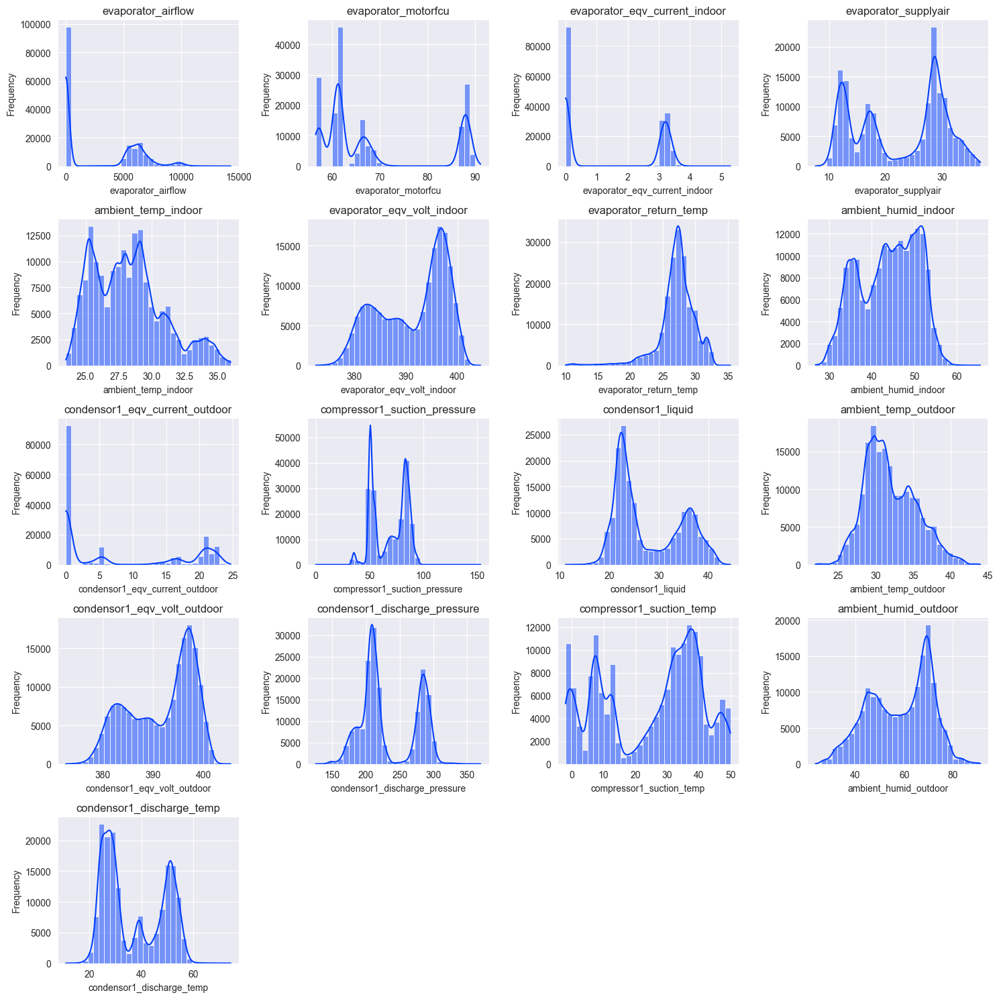

In [81]:
distribution_plot(df=df_eda, exclude_columns=time_columns, plot_size="fix")

### Log Transform Skewed features

**Dealing with Skewness** :
- **Skewed Distributions** : In many real-world datasets, features can have highly skewed distributions, with values concentrated on one side and a long tail on the other. For example, income data tends to be right-skewed, with most values being lower but a few extremely high values stretching the tail.

- **Effect of Skewness** : Skewed data can negatively impact the performance of machine learning models, especially models that assume normally distributed data (like linear regression or certain clustering algorithms).

**Why np.log1p() -> log(1+x)**
- **Stabilizing Variance** : Applying the logarithm compresses large values more than smaller ones, reducing the skewness and bringing the distribution closer to normal.
Handling Zero and Negative Values: A direct logarithm (np.log(x)) cannot handle zero or negative values since the logarithm of zero is undefined and the logarithm of a negative number is complex. np.log1p(x) is useful because it applies log(1+x), allowing it to handle zero (since log(1)=0) and keeping small positive values positive after transformation.

- **Smoothing Distributions** : For right-skewed distributions (where the tail is on the right), np.log1p() reduces the impact of extreme values, making the distribution more symmetric and closer to normal, which often benefits model performance.

**When to Use np.log1p()** :
- **Highly Skewed Data** : If you detect significant right skewness (e.g., using the skewness metric or visualizing the distribution), applying np.log1p() can help.

- **Features with Wide Ranges** : Features where a few extreme values dominate the distribution are candidates for this transformation.

- **Feature Engineering** : It’s a standard step in preprocessing pipelines to transform skewed data for better model performance.

https://arnondora.in.th/handling-skew-data-with-log-transform/

In [82]:
from scipy import stats

def skewed_apply(df, feature, transformation="boxcox"):
    """
    Applies a log transformation to reduce skewness, plots the distribution
    before and after transformation, and returns the updated DataFrame.

    Args:
        df (pd.DataFrame): DataFrame containing the data.
        feature (str): The name of the feature to transform and plot.

    Returns:
        pd.DataFrame: The updated DataFrame with the transformed feature.
    """
    # Set up the matplotlib figure with 2 columns and 1 row
    fig, axes = plt.subplots(1, 2, figsize=(15, 5))  # 1 row, 2 columns

    # Plot the distribution of the original feature (before transformation)
    sns.histplot(df[feature], kde=True, ax=axes[0], bins=30)
    axes[0].set_title(f'Distribution of {feature} before skewed distribution')
    axes[0].set_xlabel(f'{feature}')
    axes[0].set_ylabel('Frequency')

    if transformation == "log" :
        # Apply log transformation to the specified feature
        # df[feature] = np.log1p( df[feature] - np.min(df[feature], axis=0) + 1)
        df[feature] = np.log(df[feature])
    if transformation == "boxcox" :
        df[feature], _ = stats.boxcox(df[feature] + 1)

    # Plot the distribution of the feature after log transformation
    sns.histplot(df[feature], kde=True, ax=axes[1], bins=30)
    axes[1].set_title(f'Distribution of {feature} after skewed distribution')
    axes[1].set_xlabel(f'{feature} (Log Transformed)')
    axes[1].set_ylabel('Frequency')

    # Adjust layout
    plt.tight_layout()
    plt.show()

    return df

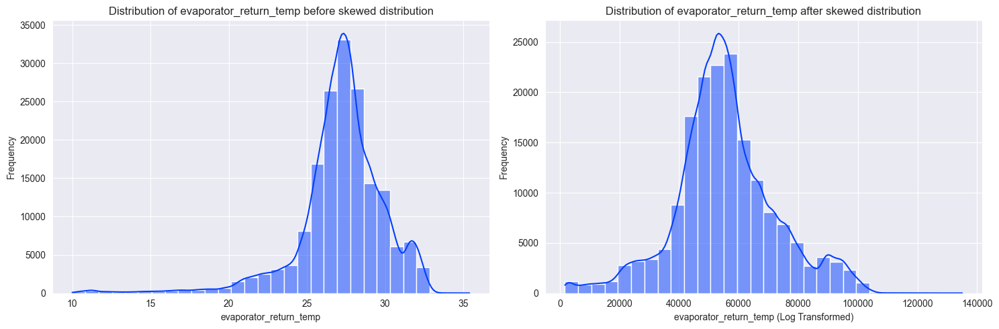

In [83]:
df_eda = skewed_apply(df=df_eda, feature="evaporator_return_temp", transformation="boxcox")

In [84]:
df_eda.keys()

Index(['evaporator_airflow', 'evaporator_motorfcu',
       'evaporator_eqv_current_indoor', 'evaporator_supplyair',
       'ambient_temp_indoor', 'evaporator_eqv_volt_indoor',
       'evaporator_return_temp', 'ambient_humid_indoor',
       'condensor1_eqv_current_outdoor', 'compressor1_suction_pressure',
       'condensor1_liquid', 'ambient_temp_outdoor',
       'condensor1_eqv_volt_outdoor', 'condensor1_discharge_pressure',
       'compressor1_suction_temp', 'ambient_humid_outdoor',
       'condensor1_discharge_temp', 'time-diff-minutes', 'year', 'month',
       'hour', 'day', 'day_name', 'month_year', 'is_business_hours',
       'is_dayoff'],
      dtype='object')

### Apply GMM

In [95]:
features = [col for col in df_eda.columns if col not in time_columns]
features

['evaporator_airflow',
 'evaporator_motorfcu',
 'evaporator_eqv_current_indoor',
 'evaporator_supplyair',
 'ambient_temp_indoor',
 'evaporator_eqv_volt_indoor',
 'evaporator_return_temp',
 'ambient_humid_indoor',
 'condensor1_eqv_current_outdoor',
 'compressor1_suction_pressure',
 'condensor1_liquid',
 'ambient_temp_outdoor',
 'condensor1_eqv_volt_outdoor',
 'condensor1_discharge_pressure',
 'compressor1_suction_temp',
 'ambient_humid_outdoor',
 'condensor1_discharge_temp']

In [102]:
from sklearn.mixture import GaussianMixture
from sklearn.preprocessing import StandardScaler

def GaussianMixtureModel_fit_and_plot(df, exclude_columns=[]):
    
    # Get all column names except the excluded one
    features = [col for col in df.columns if col not in exclude_columns]
    print(features)

    # Step 1: Normalize/Standardize the data (since GMM is sensitive to feature scaling)
    # scaler = StandardScaler()
    # df = pd.DataFrame(scaler.fit_transform(df[features]), columns=features)
    
    # Select only numeric columns
    df = df[features].select_dtypes(include=[float, int])
    print(df.columns)


    # Step 2: Fit GMM model
    gmm = GaussianMixture(n_components=2, random_state=42)  # Assuming two components (On and Off states)
    gmm.fit(df)

    # Step 3: Predict the cluster labels (0 and 1)
    df['GMM_cluster'] = gmm.predict(df)
    
    # Set up the matplotlib figure with 4 columns and 5 rows
    fig, axes = plt.subplots(5, 4, figsize=(20, 20))  # 5 rows, 4 columns

    # Flatten axes for easy iteration
    axes = axes.flatten()
    
    # Plotting each feature's distribution with GMM clusters
    for i, column in enumerate(features):
        sns.histplot(
            data=df, 
            x=column, 
            hue='GMM_cluster', 
            palette={0: 'blue', 1: 'red'}, 
            ax=axes[i], 
            kde=True,
            bins=30
        )
        axes[i].set_title(f'Distribution of {column}')
        axes[i].set_xlabel(column)
        axes[i].set_ylabel('Frequency')

    # Hide any empty subplots if there are less than 20 features
    for j in range(len(features), 20):
        fig.delaxes(axes[j])

    # Adjust layout
    plt.tight_layout()
    plt.show()
    
    return df

['evaporator_airflow', 'evaporator_motorfcu', 'evaporator_eqv_current_indoor', 'evaporator_supplyair', 'ambient_temp_indoor', 'evaporator_eqv_volt_indoor', 'evaporator_return_temp', 'ambient_humid_indoor', 'condensor1_eqv_current_outdoor', 'compressor1_suction_pressure', 'condensor1_liquid', 'ambient_temp_outdoor', 'condensor1_eqv_volt_outdoor', 'condensor1_discharge_pressure', 'compressor1_suction_temp', 'ambient_humid_outdoor', 'condensor1_discharge_temp']
Index(['evaporator_airflow', 'evaporator_motorfcu',
       'evaporator_eqv_current_indoor', 'evaporator_supplyair',
       'ambient_temp_indoor', 'evaporator_eqv_volt_indoor',
       'evaporator_return_temp', 'ambient_humid_indoor',
       'condensor1_eqv_current_outdoor', 'compressor1_suction_pressure',
       'condensor1_liquid', 'ambient_temp_outdoor',
       'condensor1_eqv_volt_outdoor', 'condensor1_discharge_pressure',
       'compressor1_suction_temp', 'ambient_humid_outdoor',
       'condensor1_discharge_temp'],
      dtype

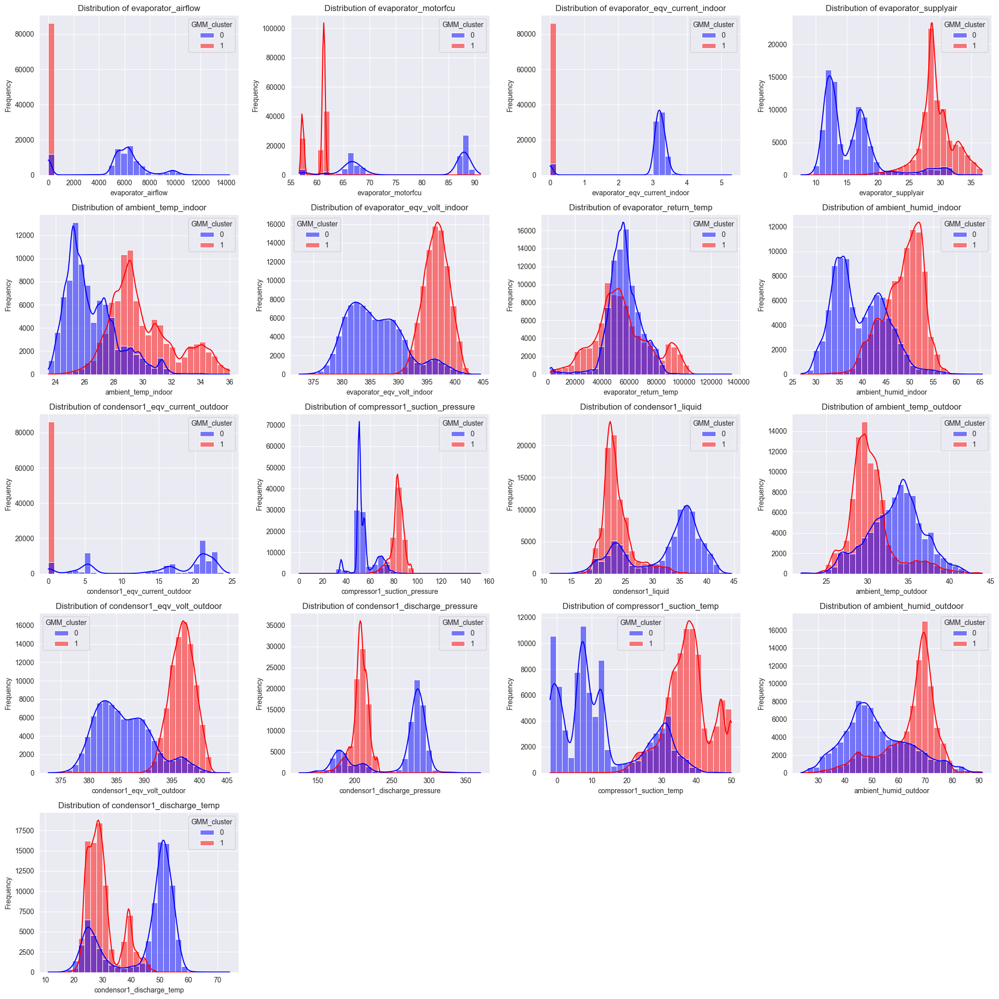

In [103]:
df_test = GaussianMixtureModel_fit_and_plot(df=df_eda, exclude_columns=time_columns)

In [106]:
df_test.keys()

Index(['evaporator_airflow', 'evaporator_motorfcu',
       'evaporator_eqv_current_indoor', 'evaporator_supplyair',
       'ambient_temp_indoor', 'evaporator_eqv_volt_indoor',
       'evaporator_return_temp', 'ambient_humid_indoor',
       'condensor1_eqv_current_outdoor', 'compressor1_suction_pressure',
       'condensor1_liquid', 'ambient_temp_outdoor',
       'condensor1_eqv_volt_outdoor', 'condensor1_discharge_pressure',
       'compressor1_suction_temp', 'ambient_humid_outdoor',
       'condensor1_discharge_temp', 'GMM_cluster'],
      dtype='object')

## Diff Pressure features

In [ ]:
# High side pressure : df.compressore1_suction_pressure
# Low side presssure : df.condensor1_discharge_pressure
df["diff_pressure"] = np.abs( df.compressor1_suction_pressure - df.condensor1_discharge_pressure)
df.diff_pressure

## Diff Temperature features

In [ ]:
df["diff_temp_evaporator"] = np.abs( df.evaporator_return_temp - df.evaporator_supplyair)
df.diff_temp_evaporator

In [ ]:
# High side temperature : df.compressor1_suction_temp
# Low side temperature : df.condensor1_discharge_temp
df["diff_temp_compressor"] = np.abs( df.compressor1_suction_temp - df.condensor1_discharge_temp)
df.diff_temp_compressor

## Rolling features

In [ ]:
def rolling_features(df_input, 
                     df_target, 
                     features:list, 
                     n_windows=1440, # n windows is trailling moving average
                     field_name="Roll-mean", 
                     method="sma"):
    
    # Simple Moving Average -> calculated by dividing the sum of a set of prices by the total number of prices found in the series
    if method == "sma":
        for feat in features:
            df_target[f"{field_name}-{feat}"] = df_input[feat].rolling(window = n_windows).mean()
    
    # Expopnential Moving Average -> places a higher weight on recent data than on older data, they are more reactive to the latest price changes than SMA
    elif method == "ema":
        for feat in features:
            df_target[f"{field_name}-{feat}"] = df_input[feat].ewm(span=n_windows, adjust=False).mean()
            
    else :
        print("choose ema or ma")
        return False
    
    return df_target

In [ ]:
rolling_df = df.copy()


# Using Moving Average
rolling_df = rolling_features(df_input=df, 
                              df_target=rolling_df, 
                              features=sensor_features, 
                              n_windows=60, 
                              field_name='SMA',
                              method='sma')

rolling_df.keys()

## Lag features

1. Capturing Temporal Dependencies: Time series data often exhibit patterns over time. For example, the value of a variable today might depend on its value from the previous day or week. Lag features help capture these dependencies.

2. Improving Predictive Power: By including past values as features, the model can learn from historical data to make better predictions about future values.

3. Handling Autocorrelation: Many time series exhibit autocorrelation, where past values influence current values. Lag features help the model account for this autocorrelation.

4. Feature Enrichment: Adding lagged values can create a richer set of features for the model to learn from, potentially improving its performance.

In [ ]:
def lag_features(df_input, 
                 df_target, 
                 features:list, 
                 lag:int, 
                 dropna:bool=False, 
                 method="ffill") :
    """
    Lag features help models learn from past data, 
    capturing temporal patterns and improving predictive performance. 
    """
    
    if method == "bfill" :
        for feat in features:
            df_target[f"Lag-{feat}"] = df_input[feat].shift(lag)
            df_target[f"Lag-{feat}"].bfill(inplace=True)
            
    elif method == "ffill" :
        for feat in features :
            df_target[f"Lag-{feat}"] = df_input[feat].shift(lag)
            df_target[f"Lag-{feat}"].ffill(inplace=True)
    else :
        print("method not defined correctly")
        return False
    
    # Drop rows with NaN values after shifting
    if dropna:
        df_target.dropna(inplace=True)
    
    return df_target

In [ ]:
lag_df = rolling_df.copy()
lag_df = lag_features(df_input=rolling_df, 
                      df_target=lag_df, 
                      features=sma_columns, 
                      lag=1440,
                      dropna=True, 
                      method="ffill")
lag_df.keys()

In [ ]:
(lag_df.loc[:, ['time', 
                'evaporator_airflow',
                'SMA-evaporator_airflow',]]
    .set_index('time')
    .plot(figsize=(20,5)))

# ⚙️ 3. Feature Selection

# ⚙️ 4. Save to csv. 